# Exploratory Spatio-Temporal Data Analysis
# Data Inspection and Descriptive Statistics - Summary Statistics

## Load data

In [1]:
import numpy as np
import pandas as pd
import polars as pl

import matplotlib.pyplot as plt

import folium
from mpl_toolkits.basemap import Basemap

%matplotlib inline

In [2]:
import xarray as xr
import glob

def preprocess_dataset(ds: xr.Dataset) -> xr.Dataset:
    """
    Preprocess the dataset to ensure the `valid_time` coordinate is in `datetime64[ns]` format.

    Args:
        ds (xr.Dataset): Input dataset.

    Returns:
        xr.Dataset: Preprocessed dataset with `valid_time` converted to datetime.
    """
    if "valid_time" in ds.coords:
        ds["valid_time"] = ds["valid_time"].dt.floor("D")  # Truncate to date only
    return ds

# Define the directory containing your NetCDF files
data_dir = 'drought-forecasting/modeling-pipeline/data/01_raw/unzipped_files/ERA5_monthly_averaged_data_on_single_levels/'

# Create a sorted list of file paths
file_list = sorted(glob.glob(data_dir + '*.nc'))

# Open multiple files as a single dataset with preprocessing applied
ds = xr.open_mfdataset(
    file_list, 
    combine='by_coords', 
    preprocess=preprocess_dataset
)


In [3]:
ds

<xarray.Dataset> Size: 55GB
Dimensions:     (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 4kB 1979-01-01 ... 2024-11-01
  * latitude    (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
  * longitude   (longitude) float64 12kB 0.0 0.25 0.5 0.75 ... 359.2 359.5 359.8
    expver      (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
Data variables: (12/24)
    cl          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...          ...
    si10        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    e           (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ro          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tp          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    pev         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    swvl1       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

# NA Values 

In [4]:
# import xarray as xr

# # Check for missing values in each variable without compute
# missing_values = {var: ds[var].isnull().any().values for var in ds.data_vars}

# # Display the results
# for var, has_missing in missing_values.items():
#     print(f"Variable '{var}': {'Has missing values' if has_missing else 'No missing values'}")


# Fill NA values

In [5]:
import xarray as xr
from typing import List, Union

def fillna_in_variables(
    ds: xr.Dataset,
    variables: List[str],
    fill_value: Union[int, float]
) -> xr.Dataset:
    """
    Fills NaN values in specified variables of an xarray.Dataset with a provided value.

    Args:
        ds (xr.Dataset): The input dataset containing the data variables.
        variables (List[str]): A list of variable names in the dataset for which to fill NaN values.
        fill_value (Union[int, float]): The value to fill NaN values with (e.g., 0).

    Returns:
        xr.Dataset: A new dataset with NaN values filled in the specified variables.
    
    Example:
        ds = fillna_in_variables(ds, ["sst", "t2m"], fill_value=0)
    """
    # Check if each variable exists in the dataset
    for var in variables:
        if var not in ds:
            raise ValueError(f"Variable '{var}' not found in the dataset.")
    
    # Fill NaN values for the specified variables
    filled_ds = ds.copy()
    for var in variables:
        filled_ds[var] = filled_ds[var].fillna(fill_value)
    
    return filled_ds

In [6]:
ds = fillna_in_variables(ds, ["sst"], fill_value=0)

In [7]:
# import xarray as xr

# # Check for missing values in each variable without compute
# missing_values = {var: ds[var].isnull().any().values for var in ds.data_vars}

# # Display the results
# for var, has_missing in missing_values.items():
#     print(f"Variable '{var}': {'Has missing values' if has_missing else 'No missing values'}")


## Data Preprocessing and Feature Engineering 

In [8]:
import numpy as np
import xarray as xr

def interpolate_to_target_grid(ds, target_lat, target_lon, method="linear"):
    """
    Interpolates an xarray Dataset to a specified target latitude and longitude grid.
    
    Parameters:
        ds (xr.Dataset): The input dataset to be interpolated.
        target_lat (array-like): Target latitude values (e.g., np.arange(-90, 90, 1)).
        target_lon (array-like): Target longitude values (e.g., np.arange(0, 360, 1)).
        method (str): Interpolation method. Defaults to 'linear'.
                      Options include 'linear', 'nearest', etc.
    
    Returns:
        xr.Dataset: The interpolated dataset on the specified target grid.
    """
    # Step 1: Ensure latitude is in ascending order
    if ds.latitude[0] > ds.latitude[-1]:
        ds = ds.sortby("latitude")
    
    # Step 2: Perform interpolation
    interpolated_ds = ds.interp(latitude=target_lat, longitude=target_lon, method=method)
    
    return interpolated_ds

# Example usage
target_lat = np.arange(-90, 90, 1)   # 1° resolution latitude
target_lon = np.arange(0, 360, 1)   # 1° resolution longitude
method = "linear"

# ds = interpolate_to_target_grid(ds, target_lat, target_lon, method)

In [9]:
ds

<xarray.Dataset> Size: 55GB
Dimensions:     (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 4kB 1979-01-01 ... 2024-11-01
  * latitude    (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
  * longitude   (longitude) float64 12kB 0.0 0.25 0.5 0.75 ... 359.2 359.5 359.8
    expver      (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
Data variables: (12/24)
    cl          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...          ...
    si10        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    e           (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ro          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tp          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    pev         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    swvl1       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

In [10]:
# Save the original attributes
original_attrs = ds['tp'].attrs

# Perform the conversion
ds['tp'] = ds['tp'] * 1000

# Restore the original attributes and update the units
ds['tp'].attrs = original_attrs
ds['tp'].attrs['units'] = 'mm'  # Update the units attribute to 'mm'

In [11]:
# Save the original attributes
original_attrs = ds['pev'].attrs

# Perform the conversion
ds['pev'] = ds['pev'] * 1000

# Restore the original attributes and update the units
ds['pev'].attrs = original_attrs
ds['pev'].attrs['units'] = 'mm'  # Update the units attribute to 'mm'

In [12]:
# Save the original attributes for t2m and d2m
t2m_attrs = ds['t2m'].attrs

# Perform the conversion from Kelvin to Celsius
ds['t2m'] = ds['t2m'] - 273.15

# Restore the original attributes and update the units
ds['t2m'].attrs = t2m_attrs
ds['t2m'].attrs['units'] = 'Celsius'

In [13]:
d2m_attrs = ds['d2m'].attrs

ds['d2m'] = ds['d2m'] - 273.15

ds['d2m'].attrs = d2m_attrs
ds['d2m'].attrs['units'] = 'Celsius'

In [14]:
# Update swvl1: Set to 1 wherever lsm indicates water (lsm == 1)
ds['swvl1'] = ds['swvl1'].where(ds['lsm'] != 0, other=1)

# Additional variables for deeper exploration

## Caluclate percent of mean 

In [15]:
import xarray as xr
import numpy as np
from typing import Tuple

def calculate_percent_of_normal(
    ds: xr.Dataset, 
    variable: str, 
    date_range: Tuple[str, str]
) -> xr.Dataset:
    """
    Generalized function to calculate Percent of Normal for a given variable.

    Args:
        ds (xr.Dataset): Input dataset containing the variable.
        variable (str): Variable name for which Percent of Normal is to be calculated.
        date_range (Tuple[str, str]): Climatology period as (start_date, end_date).

    Returns:
        xr.Dataset: Dataset with Percent of Normal added as a new variable.
    """
    # Ensure the variable exists
    if variable not in ds.variables:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")

    # Step 1: Filter dataset for the climatology period
    start_date, end_date = date_range
    ds_clim_period = ds.sel(valid_time=slice(start_date, end_date))

    # Step 2: Extract the variable and calculate monthly climatology mean
    data_clim_period = ds_clim_period[variable]
    climatology_mean = data_clim_period.groupby('valid_time.month').mean('valid_time')

    # Replace zeros and NaNs in climatology_mean with a small number
    climatology_mean = climatology_mean.where(climatology_mean > 0, other=1e-10).fillna(1e-10)

    # Step 3: Calculate Percent of Normal for all valid_time in the original dataset
    data_full = ds[variable]
    percent_of_normal = xr.apply_ufunc(
        lambda x, m: (x / m) * 100,
        data_full.groupby('valid_time.month'),
        climatology_mean,
        dask="allowed"
    )
    
    # Step 4: Add Percent of Normal to the original dataset
    ds_result = ds.copy()
    ds_result[f"{variable}_percent_of_normal"] = percent_of_normal

    return ds_result


In [16]:
date_range = ("1991-01-01", "2020-12-31")

# Assuming `ds` is your dataset
ds = calculate_percent_of_normal(ds, variable='tp', date_range=date_range)
ds = calculate_percent_of_normal(ds, variable='t2m', date_range=date_range)
ds = calculate_percent_of_normal(ds, variable='pev', date_range=date_range)
ds = calculate_percent_of_normal(ds, variable='swvl1', date_range=date_range)

## Caluclate standardized monthly anomalies based on std 

In [17]:
import xarray as xr
import numpy as np
from typing import Tuple

def calculate_standardized_anomalies(
    ds: xr.Dataset, 
    variable: str, 
    date_range: Tuple[str, str]
) -> xr.Dataset:
    """
    Calculate standardized monthly anomalies for a specific variable,
    handling cases with zero standard deviation or NaNs.
    """
    # Ensure the variable exists
    if variable not in ds.variables:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")
    
    # Step 1: Filter dataset for the climatology period
    start_date, end_date = date_range
    ds_clim_period = ds.sel(valid_time=slice(start_date, end_date))
    
    # Step 2: Extract the variable and calculate monthly climatology (mean and std)
    data_clim_period = ds_clim_period[variable]
    climatology_mean = data_clim_period.groupby('valid_time.month').mean('valid_time')
    climatology_std = data_clim_period.groupby('valid_time.month').std('valid_time')

    # Replace zero standard deviation with a small number
    climatology_std = climatology_std.where(climatology_std > 0, other=1e-10)

    # Step 3: Calculate standardized anomalies for all valid_time in the original dataset
    data_full = ds[variable]
    standardized_anomalies = xr.apply_ufunc(
        lambda x, m, s: (x - m) / s,
        data_full.groupby('valid_time.month'),
        climatology_mean,
        climatology_std,
        dask="allowed"
    )

    # Step 4: Add standardized anomalies to the original dataset
    ds_standardized_anomalies = ds.copy()
    ds_standardized_anomalies[f"{variable}_std_anomaly"] = standardized_anomalies

    return ds_standardized_anomalies

In [18]:
date_range = ("1991-01-01", "2020-12-31")

ds = calculate_standardized_anomalies(ds, variable='tp', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='t2m', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='pev', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='swvl1', date_range=date_range)

create land variables 

In [19]:
import xarray as xr

def create_land_variable(ds: xr.Dataset, variable: str, lsm_var: str = "lsm") -> xr.Dataset:
    """
    Create a land-only version of a specified variable using a land-sea mask (lsm).

    Args:
        ds (xr.Dataset): The input xarray dataset containing the variables.
        variable (str): The name of the variable to create the land-only version for.
        lsm_var (str): The name of the land-sea mask variable. Default is 'lsm'.

    Returns:
        xr.Dataset: A new dataset with the land-only version of the specified variable.

    Raises:
        ValueError: If the specified variable or land-sea mask is not present in the dataset.
    """
    if variable not in ds:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")

    if lsm_var not in ds:
        raise ValueError(f"Land-sea mask variable '{lsm_var}' not found in the dataset.")

    # Ensure the land-sea mask is binary-like
    lsm = ds[lsm_var].where(ds[lsm_var] >= 0, other=0)

    # Mask the variable using the land-sea mask (threshold for land > 0.5)
    land_variable = ds[variable].where(lsm > 0.5)

    # Add the new variable to the dataset with a descriptive name
    land_var_name = f"{variable}_land_only"
    ds[land_var_name] = land_variable

    # Add metadata to the new variable
    ds[land_var_name].attrs.update({
        "description": f"Land-only version of {variable} based on {lsm_var}",
        "units": ds[variable].attrs.get("units", "unknown"),
        "land_only": True
    })

    return ds


In [20]:
# Example usage:
ds = create_land_variable(ds, "tp_std_anomaly")
ds = create_land_variable(ds, "t2m_std_anomaly")
ds = create_land_variable(ds, "pev_std_anomaly")
ds = create_land_variable(ds, "swvl1_std_anomaly")

ds = create_land_variable(ds, "tp_percent_of_normal")
ds = create_land_variable(ds, "t2m_percent_of_normal")
ds = create_land_variable(ds, "pev_percent_of_normal")
ds = create_land_variable(ds, "swvl1_percent_of_normal")


Mask downloaded from [Global Drought Crops Monitoring](https://global-drought-crops.csic.es/#map_name=all_spei_3#map_position=2205)

In [39]:
import numpy as np
import matplotlib.pyplot as plt
import rioxarray

# Filepath to the GeoTIFF
file_path = "/teamspace/studios/this_studio/drought-forecasting/modeling-pipeline/data/01_raw/Global_cropland_3km_2019.tif"

# Open GeoTIFF with rioxarray
cropland_data = rioxarray.open_rasterio(file_path)

# Rename coordinates to latitude and longitude
cropland_data = cropland_data.rename({"x": "longitude", "y": "latitude"})

# Select the first band and drop the unnecessary dimensions
cropland_extent = cropland_data.isel(band=0).squeeze()

# Adjust longitudes of cropland_extent from [-180, 180] to [0, 360]
cropland_extent_corrected = cropland_extent.assign_coords(
    longitude=((cropland_extent.longitude + 360) % 360)
)

cropland_extent_reprojected = cropland_extent_corrected.interp(
    longitude=ds.longitude, latitude=ds.latitude, method="nearest"
)

# Normalize cropland_extent values (convert to 0-1 for masking)
cropland_mask = cropland_extent_reprojected / 100.0

# Replace 0 values in cropland_mask with NaN
cropland_mask = cropland_mask.where(cropland_mask > 0)

# Apply the mask to the 'tp' variable in ds
masked_tp_percent_of_normal = ds.tp_percent_of_normal * cropland_mask

# Add the masked 'tp' as a new variable in ds
ds = ds.assign(masked_tp_percent_of_normal=masked_tp_percent_of_normal)


In [40]:
cropland_extent

<xarray.DataArray (latitude: 5200, longitude: 14000)> Size: 73MB
[72800000 values with dtype=uint8]
Coordinates:
    band         int64 8B 1
  * longitude    (longitude) float64 112kB -170.0 -170.0 -169.9 ... 180.0 180.0
  * latitude     (latitude) float64 42kB 69.99 69.96 69.94 ... -59.96 -59.99
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [41]:
cropland_extent_corrected

<xarray.DataArray (latitude: 5200, longitude: 14000)> Size: 73MB
[72800000 values with dtype=uint8]
Coordinates:
    band         int64 8B 1
  * latitude     (latitude) float64 42kB 69.99 69.96 69.94 ... -59.96 -59.99
    spatial_ref  int64 8B 0
  * longitude    (longitude) float64 112kB 190.0 190.0 190.1 ... 180.0 180.0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [42]:
cropland_extent_reprojected

<xarray.DataArray (latitude: 721, longitude: 1440)> Size: 8MB
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
    band         int64 8B 1
    spatial_ref  int64 8B 0
  * longitude    (longitude) float64 12kB 0.0 0.25 0.5 ... 359.2 359.5 359.8
  * latitude     (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
    number       int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [45]:
cropland_mask

<xarray.DataArray (latitude: 721, longitude: 1440)> Size: 8MB
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
    band         int64 8B 1
    spatial_ref  int64 8B 0
  * longitude    (longitude) float64 12kB 0.0 0.25 0.5 ... 359.2 359.5 359.8
  * latitude     (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
    number       int64 8B 0

In [46]:
masked_tp_percent_of_normal

<xarray.DataArray (valid_time: 551, latitude: 721, longitude: 1440)> Size: 5GB
dask.array<mul, shape=(551, 721, 1440), dtype=float64, chunksize=(56, 121, 240), chunktype=numpy.ndarray>
Coordinates:
    number       int64 8B 0
  * valid_time   (valid_time) datetime64[ns] 4kB 1979-01-01 ... 2024-11-01
  * latitude     (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
  * longitude    (longitude) float64 12kB 0.0 0.25 0.5 ... 359.2 359.5 359.8
    expver       (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month        (valid_time) int64 4kB 1 2 3 4 5 6 7 8 9 ... 4 5 6 7 8 9 10 11
    band         int64 8B 1
    spatial_ref  int64 8B 0

In [43]:
ds

<xarray.Dataset> Size: 96GB
Dimensions:                            (valid_time: 551, latitude: 721,
                                        longitude: 1440)
Coordinates:
    number                             int64 8B 0
  * valid_time                         (valid_time) datetime64[ns] 4kB 1979-0...
  * latitude                           (latitude) float64 6kB 90.0 ... -90.0
  * longitude                          (longitude) float64 12kB 0.0 ... 359.8
    expver                             (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                              (valid_time) int64 4kB 1 2 3 ... 9 10 11
    band                               int64 8B 1
    spatial_ref                        int64 8B 0
Data variables: (12/41)
    cl                                 (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                                 ...
    swvl1_std_anomaly_land_only        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_percent_of_normal_land_only     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    t2m_percent_of_normal_land_only    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_percent_of_normal_land_only    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_land_only  (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    masked_tp_percent_of_normal        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

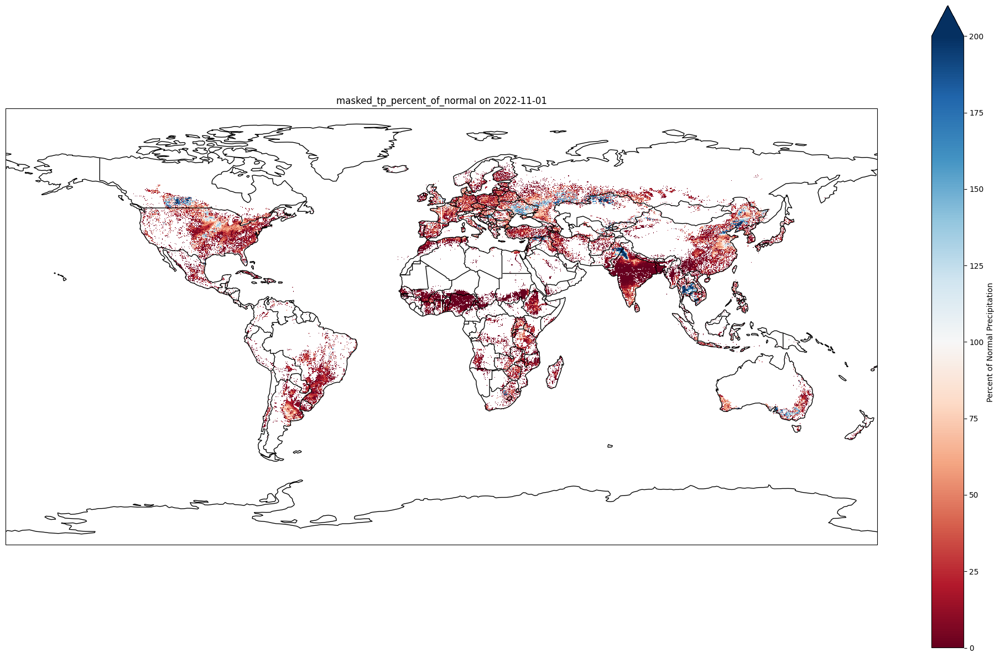

In [44]:
plot_variable_snapshot(
    ds=ds,
    variable='masked_tp_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

In [127]:
import xarray as xr
import numpy as np

def apply_mask(ds, anomaly_var, mask_ds_path, date, mask_name):
    """
    Apply a mask to the specified anomaly variable in a dataset, setting unmasked areas to NaN.

    Args:
        ds (xr.Dataset): Original dataset containing the anomaly variable.
        anomaly_var (str): The name of the anomaly variable in `ds`.
        mask_ds_path (str): File path to the mask dataset.
        date (str): Date to select from the mask dataset (format: YYYY-MM-DD).
        mask_name (str): Name for the output masked variable (e.g., 'wheat').

    Returns:
        xr.Dataset: Updated dataset with a new variable containing the masked anomaly.
    """
    # Load the mask dataset
    mask_ds = xr.open_dataset(mask_ds_path)
    mask_ds = mask_ds.sel(time=date)

    # Step 1: Adjust longitude coordinates in the mask dataset to match the range 0..360
    mask_ds = mask_ds.assign_coords(longitude=((mask_ds.longitude + 360) % 360)).sortby("longitude")

    # Step 2: Interpolate the 'value' variable from mask_ds to match the coordinates of 'ds'
    mask_interp = mask_ds['value'].interp(
        latitude=ds.latitude,
        longitude=ds.longitude
    )

    # Step 3: Create a mask where NaN is applied to areas with a value of 0 or less
    mask_with_nan = xr.where(mask_interp > 0, 1, np.nan)

    # Step 4: Apply the mask to the anomaly variable
    masked_anomaly = ds[anomaly_var] * mask_with_nan

    # Step 5: Add the masked anomaly variable to the original dataset with the specified name
    masked_var_name = f"{anomaly_var}_{mask_name}"
    ds[masked_var_name] = masked_anomaly

    return ds

In [128]:
ds = apply_mask(
    ds=ds,
    anomaly_var="tp_std_anomaly",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="t2m_std_anomaly",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="pev_std_anomaly",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="swvl1_std_anomaly",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="t2m_percent_of_normal",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="pev_percent_of_normal",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

ds = apply_mask(
    ds=ds,
    anomaly_var="swvl1_percent_of_normal",
    mask_ds_path="drought-forecasting/modeling-pipeline/data/01_raw/wheat_spei_3.nc",
    date="2024-09-08",
    mask_name="wheat"
)

## Data Inspection

SKUPIMY SIE NA     date='2022-11-01',





Ethiopia 

Seasons
- Bega is the dry season from December to January.
- Belg is a short rainy season in most parts of Ethiopia. From March to May, rainfall is highly variable and high maximum temperatures are common. 
- Kiremt is the rainy season when 85% to 95% of food crops are produced.Covering from June to August.
Source: [Seasons of Ethiopia](https://en.wikipedia.org/wiki/Seasons_of_Ethiopia)

Droughts:
- 2011 East Africa Drought: In 2011, the rains were late, falling in late April and May, and inadequate 

- 2020–2023 Horn of Africa Drought: During the 2020–2023 Horn of Africa drought, the 2022 rainy season was recorded as the driest in over 40 years, leading to severe water and food shortages in the region. 
Source: [Horn of Africa drought (2020–2023)](https://en.wikipedia.org/wiki/Horn_of_Africa_drought_(2020%E2%80%932023))

Coutries for further exploration 
- China 
- India 
- Indonesia 
- Pakistan 
- Nigeria
- Brazil
- Bangladesh 




### Area of intrest

#### Snapshots 

In [24]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_variable_snapshot(
    ds: xr.Dataset,
    variable: str,
    date: str,
    figsize: tuple = (20, 12),
    cbar_label: str = 'Value',
    title: str = None,
    cmap: str = None,
    vmin: float = None,
    vmax: float = None,
    show_countries: bool = False
) -> None:
    """
    Plots a snapshot of a specified variable from an xarray Dataset for a given date using custom or specified colormaps.
    The longitude is shifted so that 0 degrees is at the center of the plot. Optionally overlays country boundaries.

    Args:
        ds (xarray.Dataset): The xarray Dataset containing the data.
        variable (str): The variable name in the dataset to plot (e.g., 'swvl1', 't2m', 'cl').
        date (str): The date for which to plot the snapshot in 'YYYY-MM-DD' format.
        figsize (tuple, optional): Size of the plot in inches. Defaults to (20, 12).
        cbar_label (str, optional): Label for the colorbar. Defaults to 'Value'.
        title (str, optional): Title of the plot. If not provided, a default title based on the variable and date will be used.
        cmap (str, optional): Colormap name to use for the plot (e.g., 'viridis', 'plasma'). 
                              If not specified, a custom colormap is used for 'swvl1', 
                              and 'viridis' is used for other variables.
        vmin (float, optional): Minimum value for color scale. Defaults to None, which uses data-specific minimum.
        vmax (float, optional): Maximum value for color scale. Defaults to None, which uses data-specific maximum.
        show_countries (bool, optional): Whether to overlay country boundaries. Defaults to False.

    Returns:
        None: Displays the plot.
    """
    # Validate if the variable exists in the dataset
    if variable not in ds.data_vars:
        raise ValueError(
            f"Variable '{variable}' not found in the dataset. "
            f"Available variables are: {list(ds.data_vars.keys())}"
        )

    # Define custom boundaries and colors for specific variables
    if variable == 'swvl1' and cmap is None:
        boundaries = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]  # Meaningful soil moisture ranges
        colors = ['red', 'orange', 'green', 'green', 'lightblue', 'blue']  # Critical to excessive moisture
        cmap_obj = mcolors.ListedColormap(colors)
        norm = mcolors.BoundaryNorm(boundaries, cmap_obj.N)
    else:
        # Use specified colormap or default 'viridis' for other variables
        cmap_name = cmap if cmap is not None else 'viridis'
        cmap_obj = plt.get_cmap(cmap_name)

        # Use provided vmin and vmax or fall back to dataset-specific min and max
        if vmin is None:
            vmin = ds[variable].min().item()
        if vmax is None:
            vmax = ds[variable].max().item()
        norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

    # Select the data slice for the specified variable and date
    try:
        data_snapshot = ds[variable].sel(valid_time=date)
    except KeyError as e:
        raise KeyError(
            f"Date '{date}' not found in 'valid_time' coordinate."
        ) from e

    # Shift longitude from [0, 360) to [-180, 180)
    data_snapshot = data_snapshot.assign_coords(
        longitude=(((data_snapshot.longitude + 180) % 360) - 180)
    ).sortby('longitude')

    # Initialize the plot with PlateCarree projection
    fig, ax = plt.subplots(figsize=figsize, subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plot the data with the custom or specified/default colormap and normalization
    data_snapshot.plot(
        ax=ax,
        cmap=cmap_obj,
        norm=norm,
        cbar_kwargs={'label': cbar_label},
        transform=ccrs.PlateCarree()
    )

    # Overlay country boundaries if requested
    if show_countries:
        ax.add_feature(cfeature.BORDERS, linewidth=1, edgecolor='black')  # Country borders
        ax.add_feature(cfeature.COASTLINE, linewidth=1, edgecolor='black')  # Coastlines
    
    # Set the plot title
    if title is None:
        # Attempt to use the 'long_name' attribute; fallback to variable name
        long_name = ds[variable].attrs.get('long_name', variable)
        title = f'{long_name} on {date}'
    ax.set_title(title)

    # Improve layout and display the plot
    plt.tight_layout()
    plt.show()


##### Total precipitation

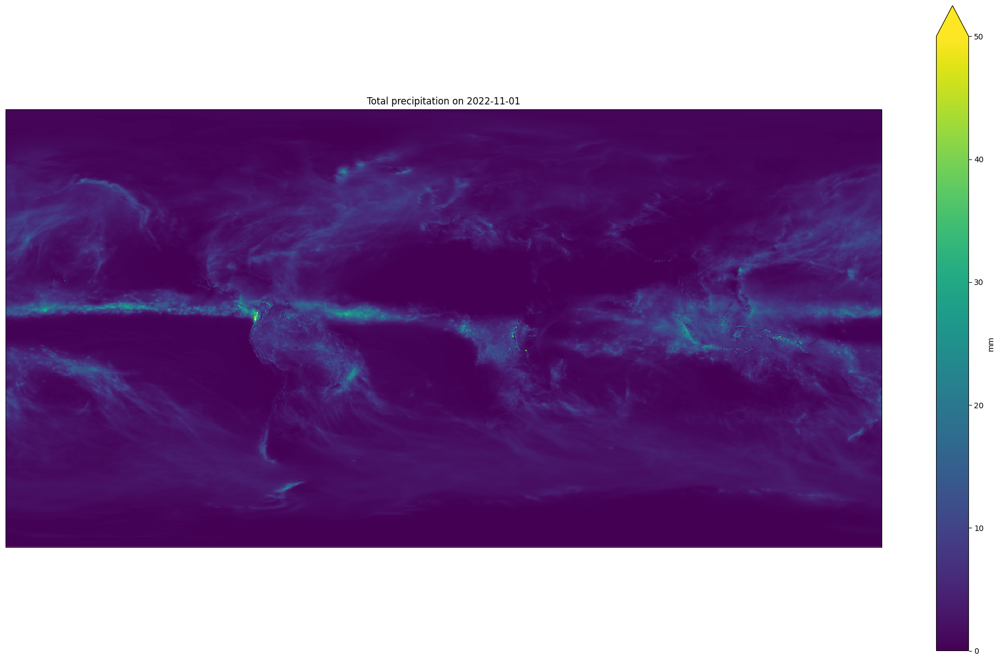

In [54]:
plot_variable_snapshot(
    ds=ds,
    variable='tp',
    date='2022-11-01',
    cbar_label='mm',
    cmap='viridis',
    vmin=0.0,
    vmax=50,
)

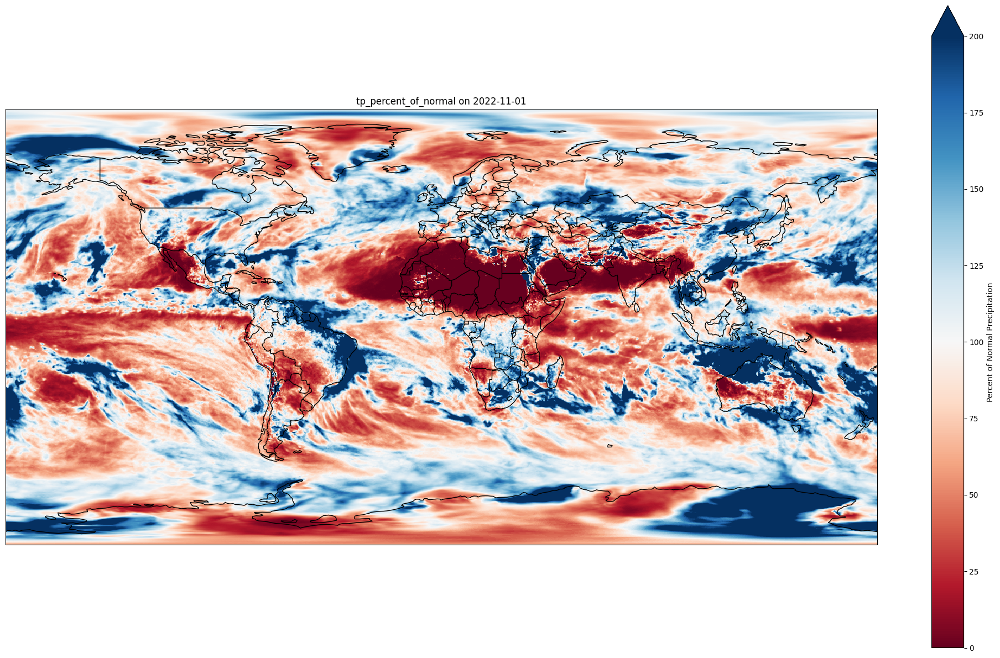

In [80]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

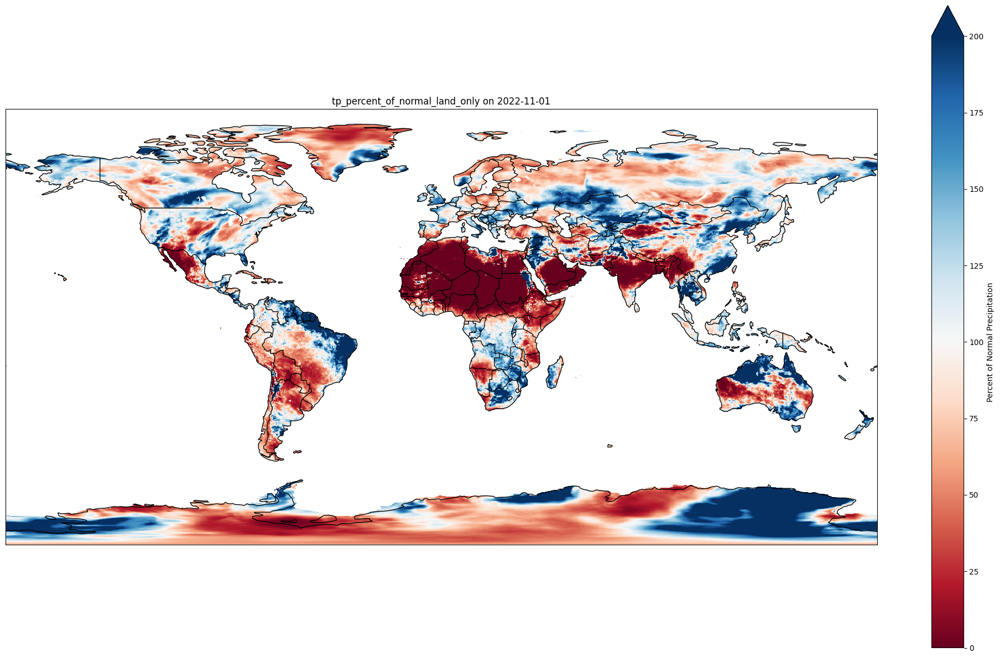

In [101]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_percent_of_normal_land_only',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

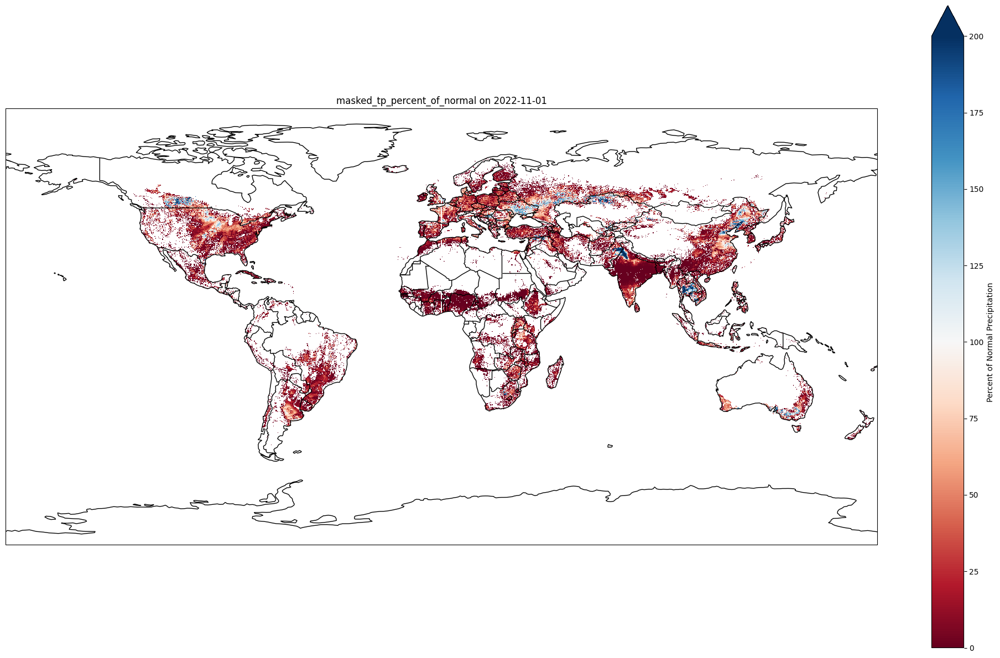

In [28]:
plot_variable_snapshot(
    ds=ds,
    variable='masked_tp_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

In [58]:
ds

<xarray.Dataset> Size: 124GB
Dimensions:                            (valid_time: 551, latitude: 721,
                                        longitude: 1440)
Coordinates:
    number                             int64 8B 0
  * valid_time                         (valid_time) datetime64[ns] 4kB 1979-0...
  * latitude                           (latitude) float64 6kB 90.0 ... -90.0
  * longitude                          (longitude) float64 12kB 0.0 ... 359.8
    expver                             (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                              (valid_time) int64 4kB 1 2 3 ... 9 10 11
    time                               datetime64[ns] 8B 2024-09-08
Data variables: (12/47)
    cl                                 (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                                 ...
    t2m_std_anomaly_wheat              (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_wheat              (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_wheat            (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    t2m_percent_of_normal_wheat        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_percent_of_normal_wheat        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_wheat      (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

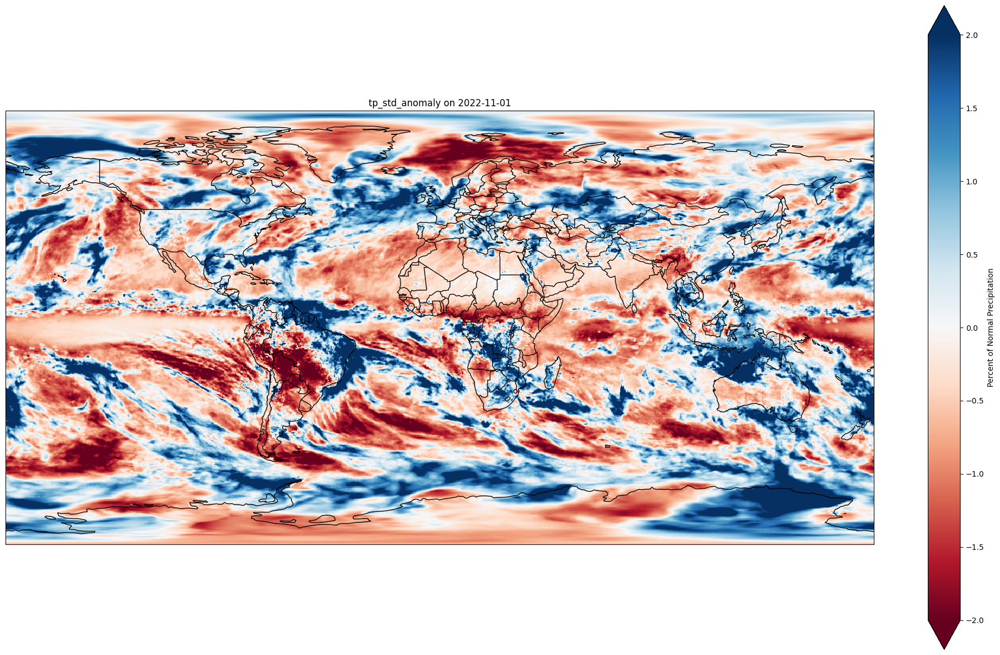

In [102]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_std_anomaly',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

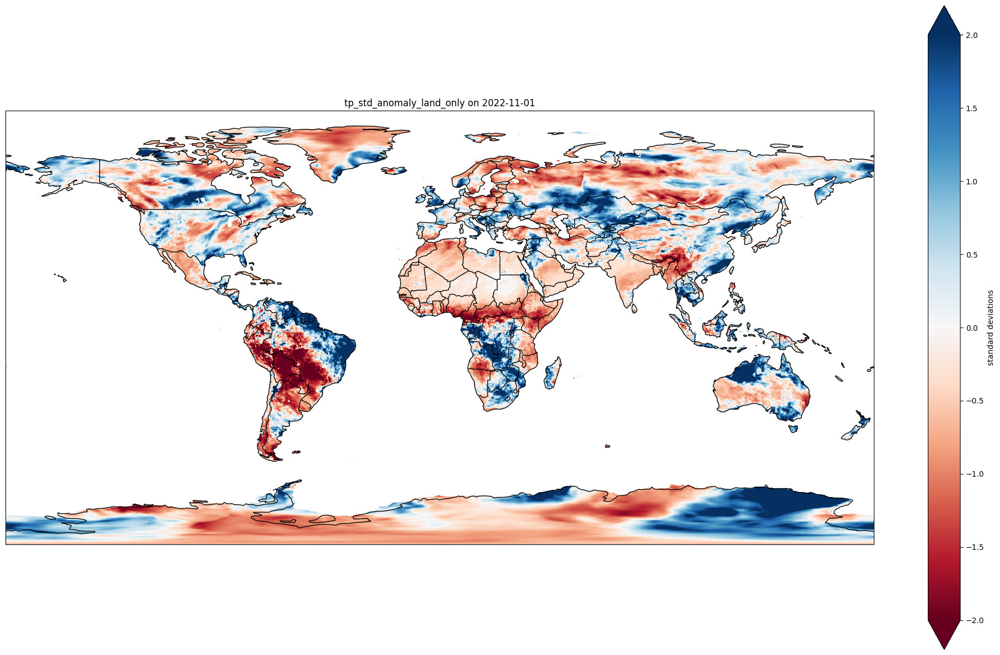

In [103]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_std_anomaly_land_only',
    date='2022-11-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2.0,
    vmax=2.0,
    show_countries=True
)

##### 2 Metre Temperature

In [105]:
ds

<xarray.Dataset> Size: 124GB
Dimensions:                            (valid_time: 551, latitude: 721,
                                        longitude: 1440)
Coordinates:
    number                             int64 8B 0
  * valid_time                         (valid_time) datetime64[ns] 4kB 1979-0...
  * latitude                           (latitude) float64 6kB 90.0 ... -90.0
  * longitude                          (longitude) float64 12kB 0.0 ... 359.8
    expver                             (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                              (valid_time) int64 4kB 1 2 3 ... 9 10 11
    time                               datetime64[ns] 8B 2024-09-08
Data variables: (12/47)
    cl                                 (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                                (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                                 ...
    t2m_std_anomaly_wheat              (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_wheat              (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_wheat            (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    t2m_percent_of_normal_wheat        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_percent_of_normal_wheat        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_wheat      (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

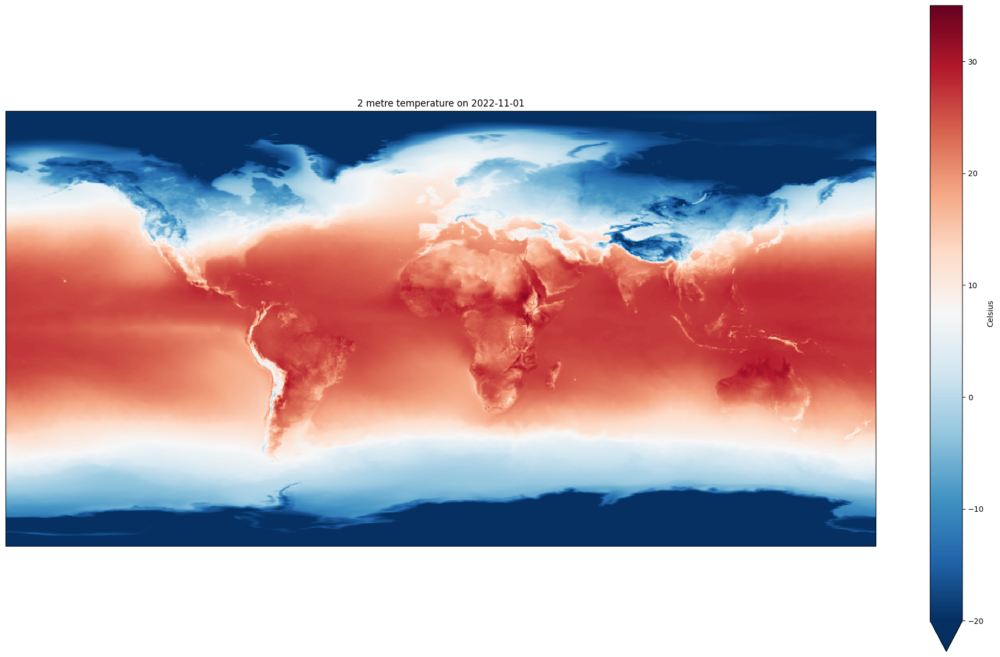

In [132]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m',
    date='2022-11-01',
    cbar_label='Celsius',
    cmap='RdBu_r',
    vmin=-20,
    vmax=35,
)

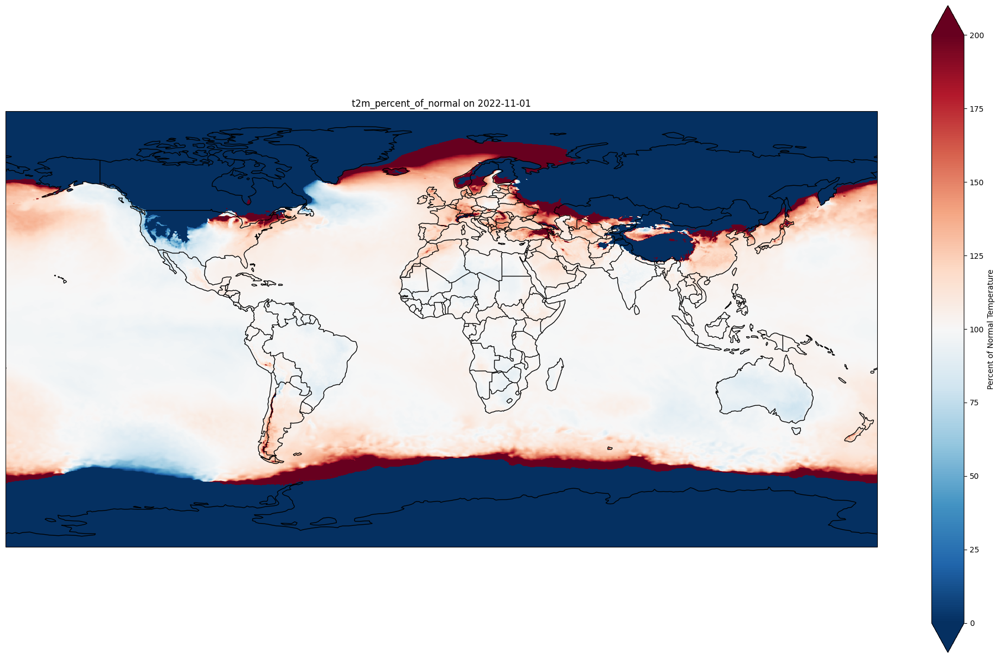

In [135]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Temperature',
    cmap='RdBu_r',
    vmin=0,
    vmax=200,
    show_countries=True
)

##### Volumetric Soil Water Layer 1

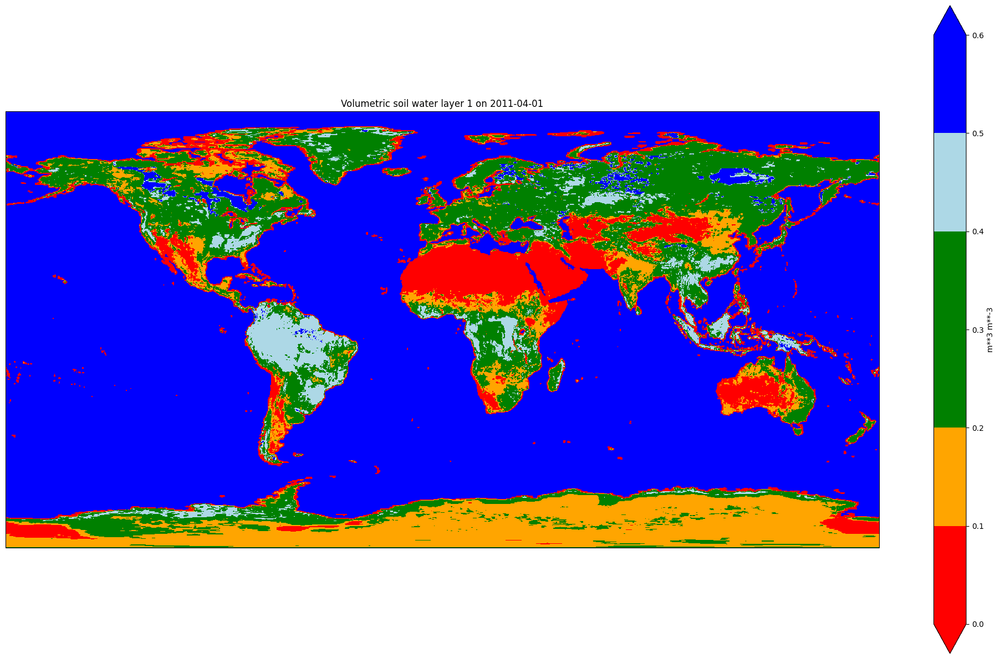

In [31]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1',
    date='2011-04-01',
    cbar_label='m**3 m**-3',
)

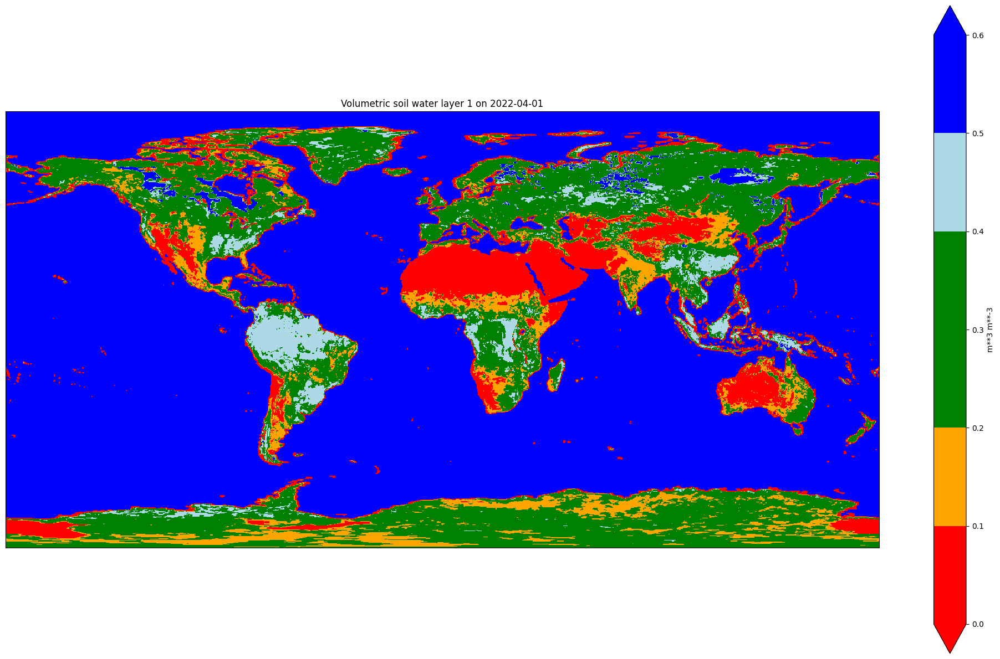

In [32]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1',
    date='2022-04-01',
    cbar_label='m**3 m**-3',
)

In [33]:
ds

<xarray.Dataset> Size: 82GB
Dimensions:                 (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number                  int64 8B 0
  * valid_time              (valid_time) datetime64[ns] 4kB 1979-01-01 ... 20...
  * latitude                (latitude) float64 6kB 90.0 89.75 ... -89.75 -90.0
  * longitude               (longitude) float64 12kB 0.0 0.25 ... 359.5 359.8
    expver                  (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                   (valid_time) int64 4kB 1 2 3 4 5 6 ... 6 7 8 9 10 11
    time                    datetime64[ns] 8B 2024-09-08
Data variables: (12/32)
    cl                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                      ...
    swvl1_std_anomaly       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_pnp_corn             (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_std_anomaly_corn     (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_corn  (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_corn    (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

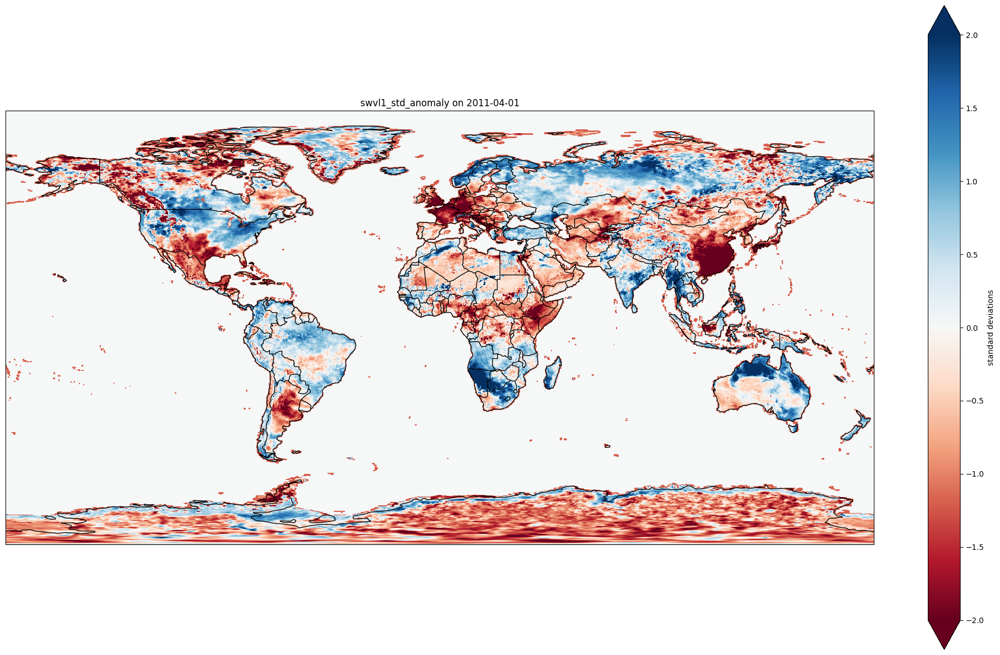

In [34]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly',
    date='2011-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

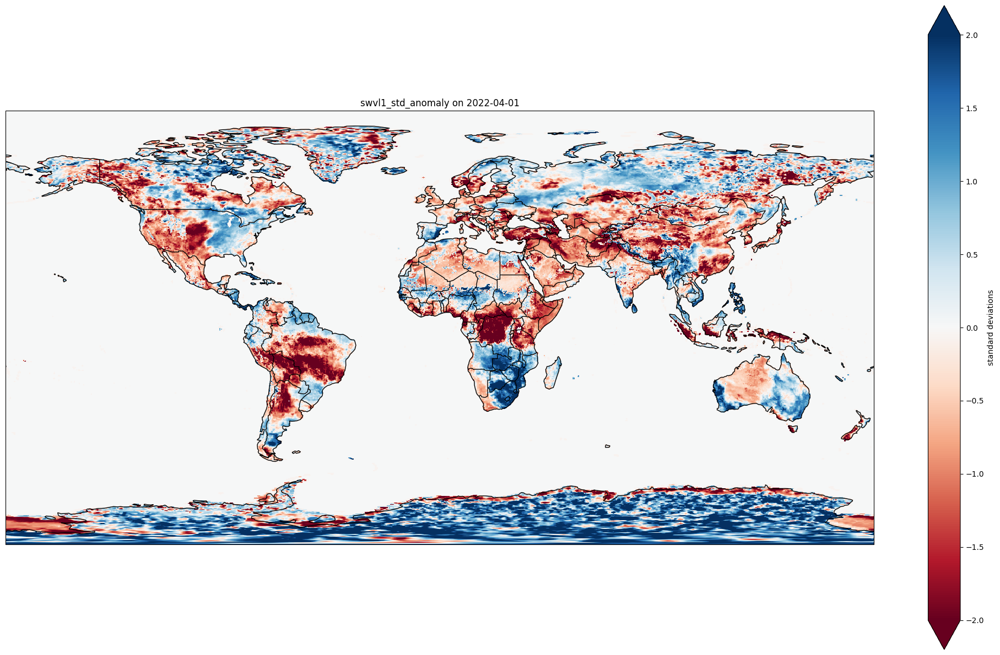

In [35]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly',
    date='2022-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

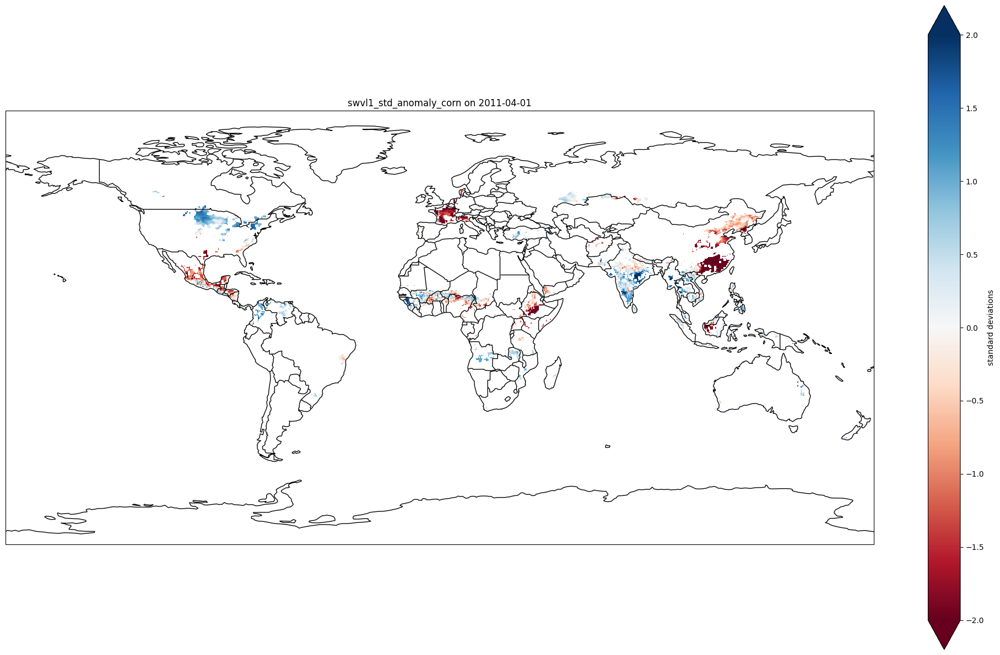

In [36]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly_wheat',
    date='2011-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

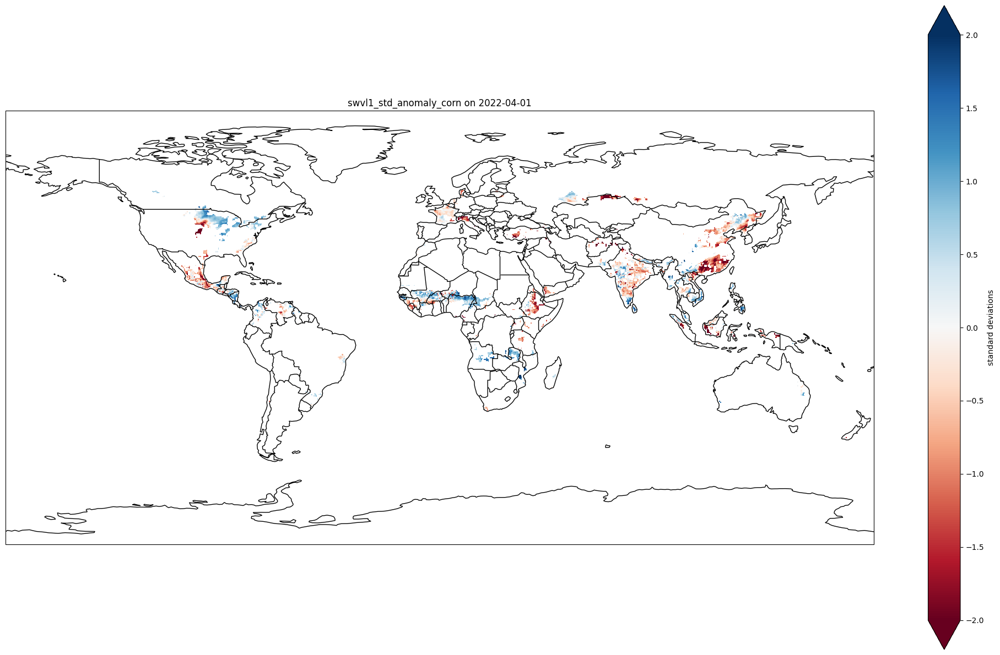

In [37]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly_wheat',
    date='2022-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

##### Potential evaporation

In [ ]:
ds

In [38]:
# vmin = ds['pev'].min().compute().item()
# vmax = ds['pev'].max().compute().item()

# vmin, vmax

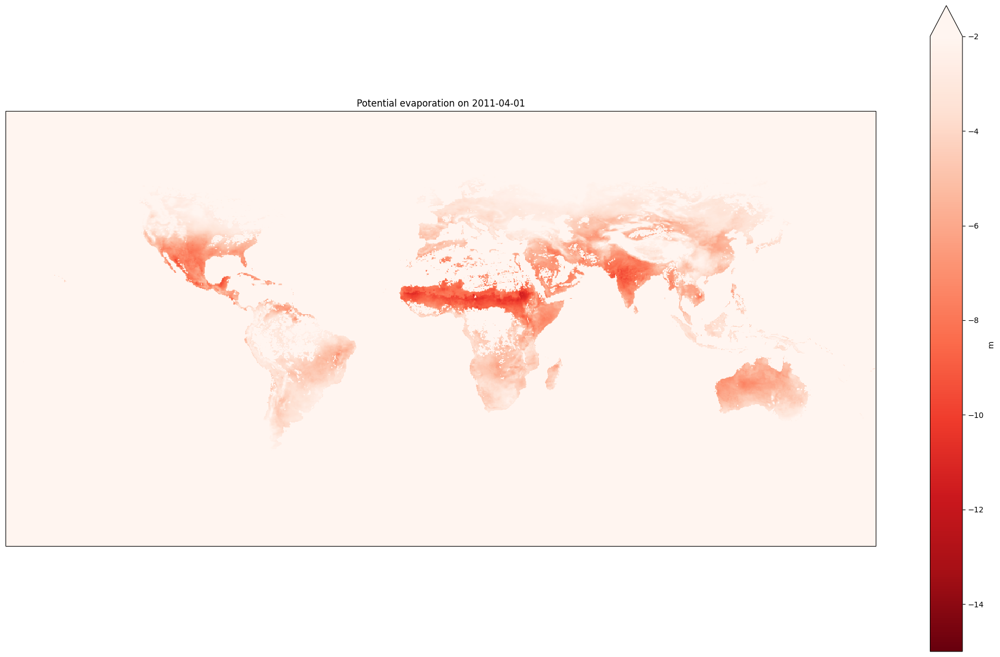

In [39]:
plot_variable_snapshot(
    ds=ds,
    variable='pev',
    date='2011-04-01',
    cbar_label='m',
    cmap='Reds_r',
    vmin=-15,
    vmax=-2
)

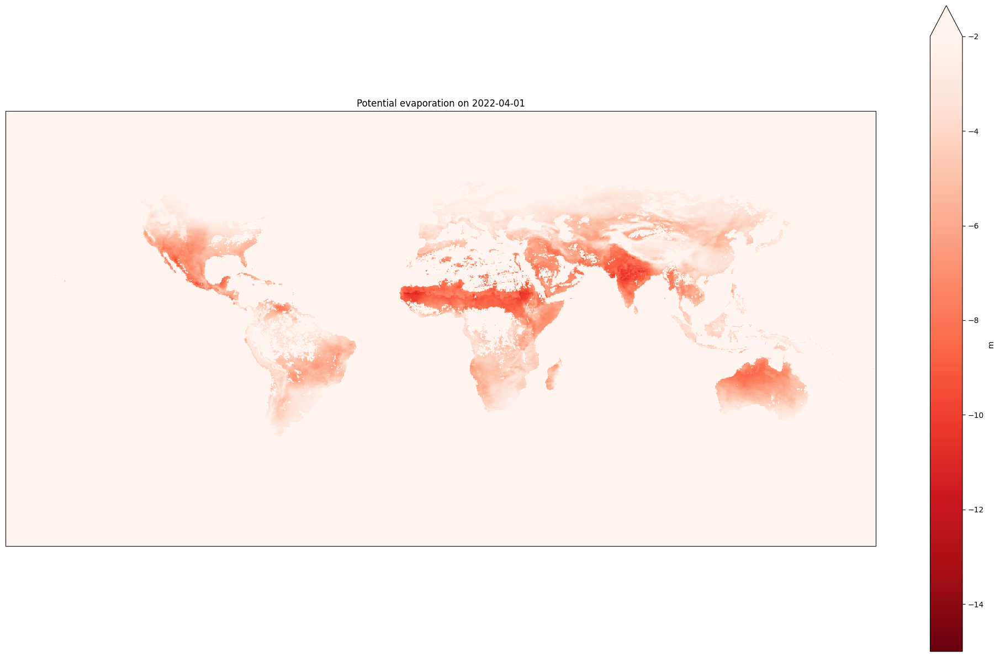

In [40]:
plot_variable_snapshot(
    ds=ds,
    variable='pev',
    date='2022-04-01',
    cbar_label='m',
    cmap='Reds_r',
    vmin=-15,
    vmax=-2
)

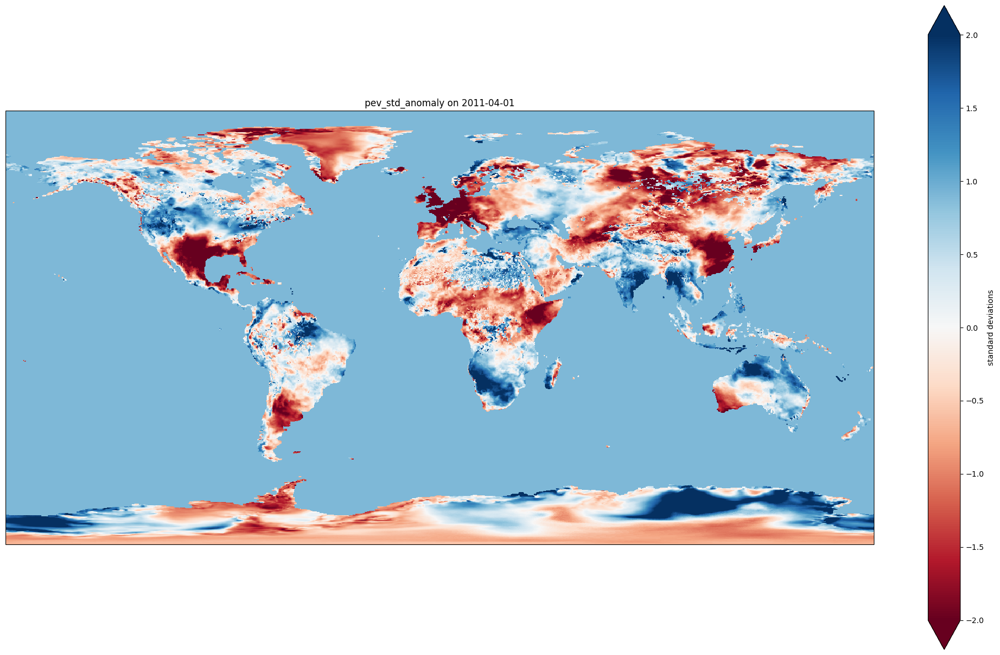

In [41]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly',
    date='2011-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2.0,
    vmax=2.0
)

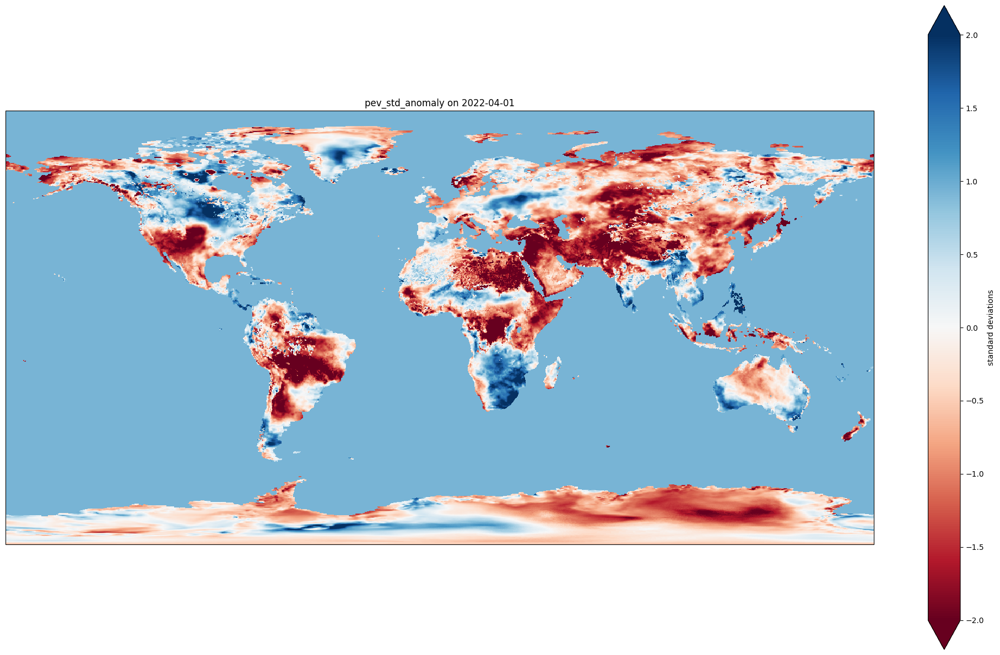

In [42]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly',
    date='2022-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2.0,
    vmax=2.0
)

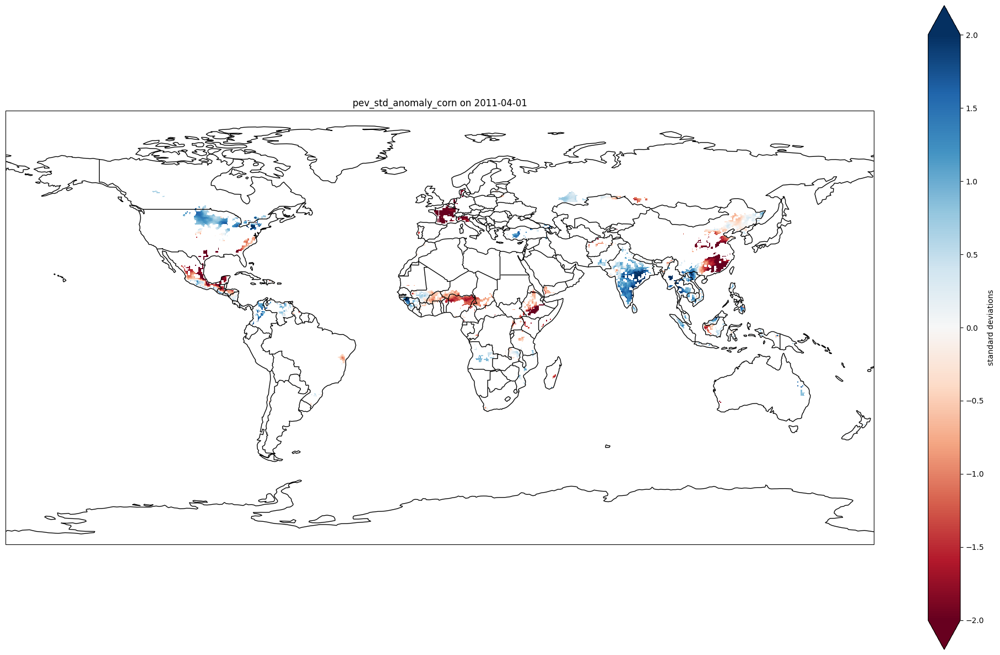

In [43]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly_wheat',
    date='2011-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

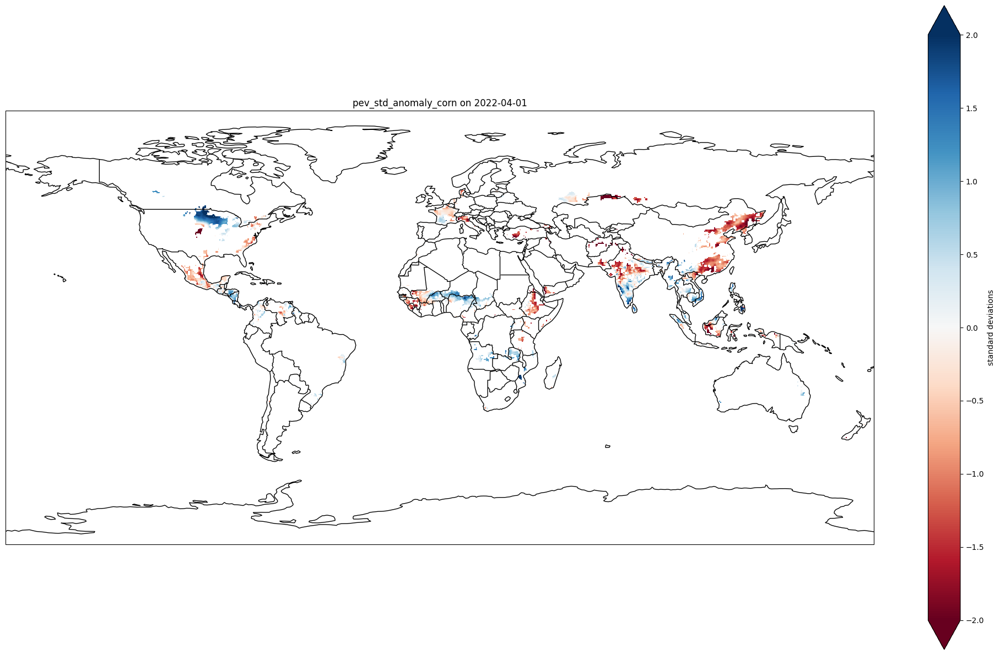

In [44]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly_wheat',
    date='2022-04-01',
    cbar_label='standard deviations',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

#### Whole range of dates

In [26]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from typing import Optional

def visualize_variable_on_map(
    dataset: xr.Dataset,
    variable: str,
    time_dim: str = 'valid_time',
    lat_dim: str = 'latitude',
    lon_dim: str = 'longitude',
    plot_type: str = 'scatter_geo',
    downsample_factor: Optional[int] = 1,
    projection: str = 'natural earth',
    color_scale: Optional[list] = None,
    custom_boundaries: Optional[list] = None,
    title: Optional[str] = None,
    animation_frame: Optional[str] = None,
    hover_precision: int = 2,
    custom_colorbar_title: Optional[str] = None,
    start_date: Optional[str] = None,
    end_date: Optional[str] = None,
    **kwargs
) -> go.Figure:
    """
    Function to visualize any variable from an xarray Dataset on a map with optional animation using Plotly.
    """

    # Extract GRIB metadata for title and colorbar
    grib_name = dataset[variable].attrs.get("GRIB_name", variable)
    grib_units = dataset[variable].attrs.get("GRIB_units", "")
    
    # Use GRIB_name as title if not provided
    if not title:
        title = f"{grib_name}"
        if start_date or end_date:
            title += f" ({start_date or ''} to {end_date or ''})"
    
    # Set colorbar title
    colorbar_title = custom_colorbar_title if custom_colorbar_title else grib_units

    # Extract the DataArray
    da = dataset[variable]

    # Check if variable dimensions are correct
    for dim in [time_dim, lat_dim, lon_dim]:
        if dim not in da.dims:
            raise ValueError(f"Dimension '{dim}' not found in variable '{variable}'.")

    # Filter by date range if specified
    if start_date or end_date:
        if start_date:
            da = da.sel({time_dim: da[time_dim] >= pd.to_datetime(start_date)})
        if end_date:
            da = da.sel({time_dim: da[time_dim] <= pd.to_datetime(end_date)})

    # Downsample if required
    if downsample_factor > 1:
        da = da.coarsen({lat_dim: downsample_factor, lon_dim: downsample_factor}, boundary='trim').mean()

    # Define custom boundaries and color scale if provided
    if custom_boundaries and color_scale:
        boundaries = custom_boundaries
        cmap = mcolors.ListedColormap(color_scale)
        norm = mcolors.BoundaryNorm(boundaries, cmap.N)
        color_min, color_max = boundaries[0], boundaries[-1]
    else:
        # Default min and max for the color scale
        color_min = da.min().item()
        color_max = da.max().item()

    # Plotting
    if plot_type == 'scatter_geo':
        df = da.to_dataframe().reset_index().dropna(subset=[variable])

        fig = px.scatter_geo(
            df,
            lat=lat_dim,
            lon=lon_dim,
            color=variable,
            animation_frame=animation_frame,
            projection=projection,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            labels={variable: grib_name},
            hover_data={variable: f":.{hover_precision}f"},
            range_color=(color_min, color_max),  # Set constant color range
            **kwargs
        )

        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )
    
    elif plot_type == 'imshow':
        z = da.mean(dim=time_dim).values  # Aggregate over time dimension for a static plot
        if da[lat_dim][0] > da[lat_dim][-1]:
            z = z[::-1, :]
        
        fig = px.imshow(
            z,
            labels=dict(x=lon_dim, y=lat_dim, color=grib_name),
            x=da[lon_dim].values,
            y=da[lat_dim].values,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            range_color=(color_min, color_max),  # Set constant color range
            **kwargs
        )
        
        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )
    else:
        raise ValueError(f"Plot type '{plot_type}' is not supported.")
    
    return fig

In [28]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from typing import Optional

def visualize_variable_on_map(
    dataset: xr.Dataset,
    variable: str,
    time_dim: str = 'valid_time',
    lat_dim: str = 'latitude',
    lon_dim: str = 'longitude',
    plot_type: str = 'scatter_geo',
    downsample_factor: Optional[int] = 1,
    projection: str = 'natural earth',
    color_scale: Optional[list] = None,
    custom_boundaries: Optional[list] = None,
    title: Optional[str] = None,
    animation_frame: Optional[str] = None,
    hover_precision: int = 2,
    custom_colorbar_title: Optional[str] = None,
    start_date: Optional[str] = None,
    end_date: Optional[str] = None,
    vmin: Optional[float] = None,
    vmax: Optional[float] = None,
    **kwargs
) -> go.Figure:
    """
    Function to visualize any variable from an xarray Dataset on a map with optional animation using Plotly.
    """

    # Extract GRIB metadata for title and colorbar
    grib_name = dataset[variable].attrs.get("GRIB_name", variable)
    grib_units = dataset[variable].attrs.get("GRIB_units", "")
    
    # Use GRIB_name as title if not provided
    if not title:
        title = f"{grib_name}"
        if start_date or end_date:
            title += f" ({start_date or ''} to {end_date or ''})"
    
    # Set colorbar title
    colorbar_title = custom_colorbar_title if custom_colorbar_title else grib_units

    # Extract the DataArray
    da = dataset[variable]

    # Check if variable dimensions are correct
    for dim in [time_dim, lat_dim, lon_dim]:
        if dim not in da.dims:
            raise ValueError(f"Dimension '{dim}' not found in variable '{variable}'.")

    # Filter by date range if specified
    if start_date or end_date:
        if start_date:
            da = da.sel({time_dim: da[time_dim] >= pd.to_datetime(start_date)})
        if end_date:
            da = da.sel({time_dim: da[time_dim] <= pd.to_datetime(end_date)})

    # Downsample if required
    if downsample_factor > 1:
        da = da.coarsen({lat_dim: downsample_factor, lon_dim: downsample_factor}, boundary='trim').mean()

    # Define custom boundaries and color scale if provided
    if custom_boundaries and color_scale:
        boundaries = custom_boundaries
        cmap = mcolors.ListedColormap(color_scale)
        norm = mcolors.BoundaryNorm(boundaries, cmap.N)
        color_min, color_max = boundaries[0], boundaries[-1]
    else:
        # Default min and max for the color scale
        color_min = vmin if vmin is not None else da.min().item()
        color_max = vmax if vmax is not None else da.max().item()

    # Plotting
    if plot_type == 'scatter_geo':
        df = da.to_dataframe().reset_index().dropna(subset=[variable])

        fig = px.scatter_geo(
            df,
            lat=lat_dim,
            lon=lon_dim,
            color=variable,
            animation_frame=animation_frame,
            projection=projection,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            labels={variable: grib_name},
            hover_data={variable: f":.{hover_precision}f"},
            range_color=(color_min, color_max),  # Set constant color range
            **kwargs
        )

        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )
    
    elif plot_type == 'imshow':
        z = da.mean(dim=time_dim).values  # Aggregate over time dimension for a static plot
        if da[lat_dim][0] > da[lat_dim][-1]:
            z = z[::-1, :]
        
        fig = px.imshow(
            z,
            labels=dict(x=lon_dim, y=lat_dim, color=grib_name),
            x=da[lon_dim].values,
            y=da[lat_dim].values,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            range_color=(color_min, color_max),  # Set constant color range
            **kwargs
        )
        
        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )
    else:
        raise ValueError(f"Plot type '{plot_type}' is not supported.")
    
    return fig


In [27]:
ds

<xarray.Dataset> Size: 105GB
Dimensions:                        (valid_time: 551, latitude: 721,
                                    longitude: 1440)
Coordinates:
    number                         int64 8B 0
  * valid_time                     (valid_time) datetime64[ns] 4kB 1979-01-01...
  * latitude                       (latitude) float64 6kB 90.0 89.75 ... -90.0
  * longitude                      (longitude) float64 12kB 0.0 0.25 ... 359.8
    expver                         (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                          (valid_time) int64 4kB 1 2 3 4 ... 8 9 10 11
    time                           datetime64[ns] 8B 2024-09-08
Data variables: (12/39)
    cl                             (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                            (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                            (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                            (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                            (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                            (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                             ...
    t2m_std_anomaly_wheat          (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_wheat          (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_wheat        (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    t2m_percent_of_normal_wheat    (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_percent_of_normal_wheat    (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_wheat  (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

In [21]:
# variable = 'tp_percent_of_normal'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=15,
#     color_scale = 'Bluered',
#     start_date = '2020-01-01T00:00:00.000000000',
#     end_date = '2023-12-01T00:00:00.000000000',
#     vmin = 0,
#     vmax = 200
# )
# fig.show()

In [46]:
# # Define custom boundaries and colors
# custom_boundaries = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
# custom_colors = ['red', 'orange', 'green', 'green', 'lightblue', 'blue']  # Reflect critical to excessive moisture

# # Call the function with the updated arguments
# variable = 'swvl1'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale=custom_colors,
#     custom_boundaries=custom_boundaries,
#     title='Volumetric Soil Water Layer 1'
# )

# fig.show()

In [47]:
# variable = 'u10'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=15,
#     color_scale = 'Bluered'
# )
# fig.show()

In [48]:
# variable = 'u10'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=15,
#     color_scale = 'Bluered'
# )
# fig.show()

In [49]:
# variable = 'v10'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Bluered'
# )
# fig.show()

In [50]:
# variable = 't2m'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Thermal'
# )
# fig.show()

In [51]:
# variable = 'sst'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Plasma'
# )
# fig.show()

In [52]:
# variable = 'sp'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Plasma'
# )
# fig.show()

In [53]:
# variable = 'tp'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Blues'
# )
# fig.show()

In [54]:
# variable = 'ssr'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'YlOrBr'
# )
# fig.show()

In [55]:
# variable = 'ssrd'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'YlOrBr'
# )
# fig.show()

In [56]:
# variable = 'tcc'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'BuPu'
# )
# fig.show()

In [57]:
# variable = 'cl'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Blues'
# )
# fig.show()

In [58]:
# variable = 'e'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'YlGnBu'
# )
# fig.show()

In [59]:
# variable = 'pev'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'YlGnBu'
# )
# fig.show()

In [60]:
# variable = 'ro'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'dense'
# )
# fig.show()

In [61]:
# variable = 'asn'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'ice'
# )
# fig.show()

In [62]:
# variable = 'rsn'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'ice'
# )
# fig.show()

In [63]:
# variable = 'sd'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'ice'
# )
# fig.show()

In [64]:
# variable = 'slt'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Rainbow'
# )
# fig.show()

In [65]:
# variable = 'cvh'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'YlGn'
# )
# fig.show()

In [66]:
# variable = 'lai_hv'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'tempo'
# )
# fig.show()

In [67]:
# variable = 'tvh'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Rainbow'
# )
# fig.show()

In [68]:
# variable = 'z'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'RdBu_r'
# )
# fig.show()

In [69]:
# variable = 'lsm'

# fig = visualize_variable_on_map(
#     dataset=ds,
#     variable=variable,
#     plot_type='scatter_geo',
#     animation_frame='valid_time',
#     downsample_factor=12,
#     color_scale = 'Purpor'
# )
# fig.show()

### Missing values

In [70]:
import xarray as xr

def check_missing_percentage(dataset: xr.Dataset) -> dict:
    """
    Calculate the percentage of missing values for each variable in the xarray.Dataset.

    Args:
        dataset (xr.Dataset): The input dataset.

    Returns:
        dict: A dictionary with variable names as keys and their respective missing percentage as values.
    """
    missing_percentages = {}
    for var in dataset.data_vars:
        data = dataset[var]
        # Calculate the number of missing values and total elements
        missing_count = data.isnull().sum().item()
        total_count = data.size
        # Calculate the missing percentage
        missing_percentage = (missing_count / total_count) * 100
        missing_percentages[var] = missing_percentage
    
    return missing_percentages


In [71]:
# # Example usage
# missing_perc = check_missing_percentage(ds)

In [72]:
# missing_perc

In [73]:
# # Example usage
# missing_perc_after_filling = check_missing_percentage(ds)

In [74]:
# missing_perc_after_filling

### Distributions

In [135]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Optional

def plot_variable_distributions(ds: xr.Dataset, variables: Optional[List[str]] = None) -> None:
    """
    Plot the distribution of specified variables in the xarray Dataset.
    If no variables are specified, plot the distributions of all variables.

    Args:
        ds (xr.Dataset): The xarray dataset containing variables to visualize.
        variables (List[str], optional): List of variable names to plot.
                                         If None, plots all variables.
    """
    # Determine variables to plot
    variables_to_plot = variables if variables else list(ds.data_vars)
    
    for var in variables_to_plot:
        if var not in ds:
            print(f"Variable '{var}' not found in the dataset. Skipping.")
            continue
        
        data = ds[var].values.flatten()  # Flatten the data for distribution plot
        
        # Remove NaN values to avoid plotting issues
        data = data[~np.isnan(data)]
        
        plt.figure(figsize=(10, 5))
        plt.hist(data, bins=50, alpha=0.7, color='violet')
        plt.title(f'Distribution of {var}')
        plt.xlabel(var)
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

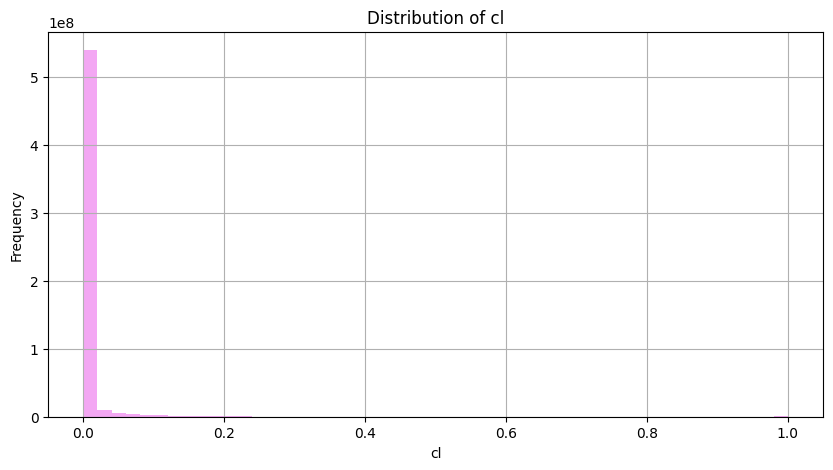

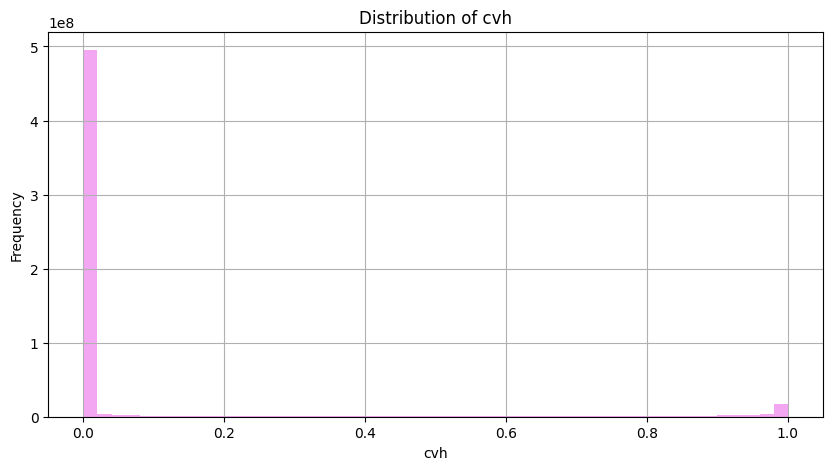

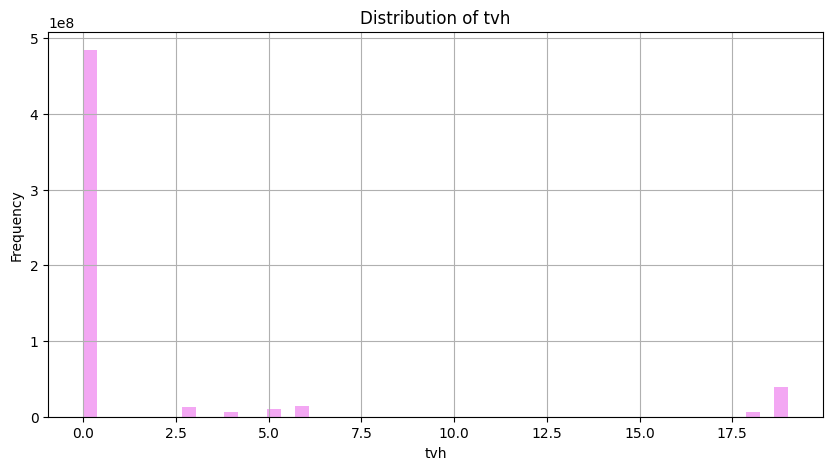

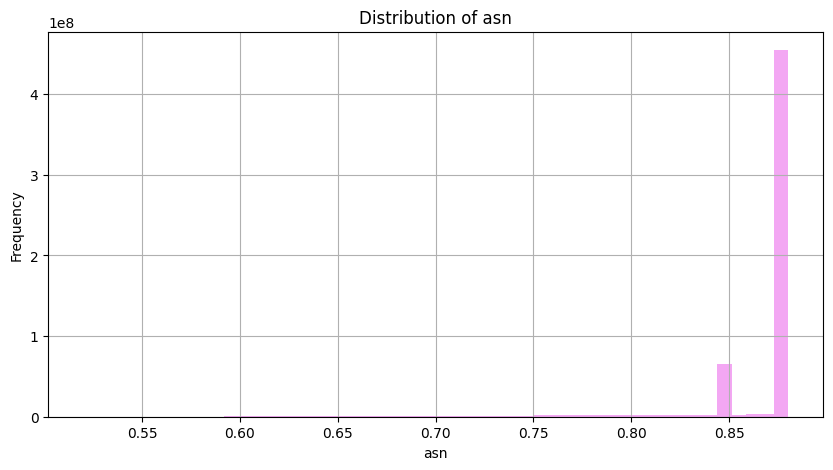

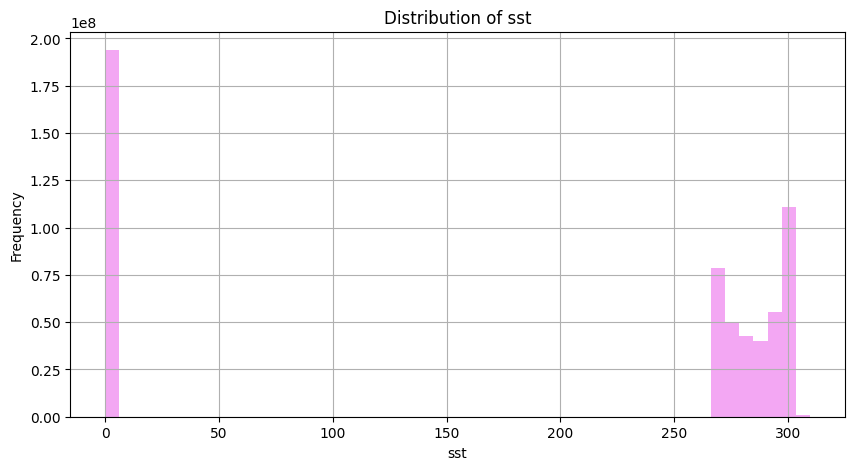

...

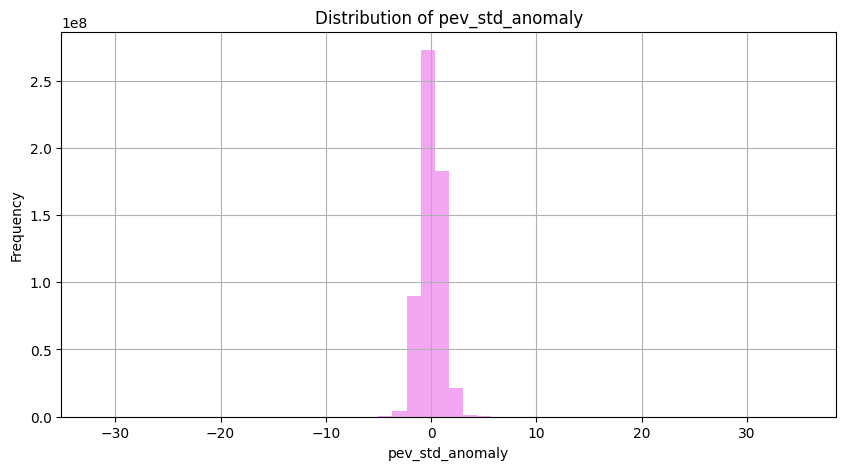

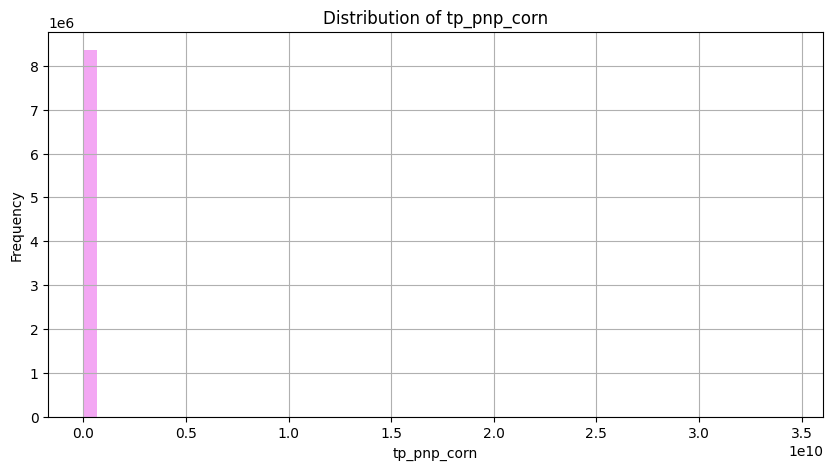

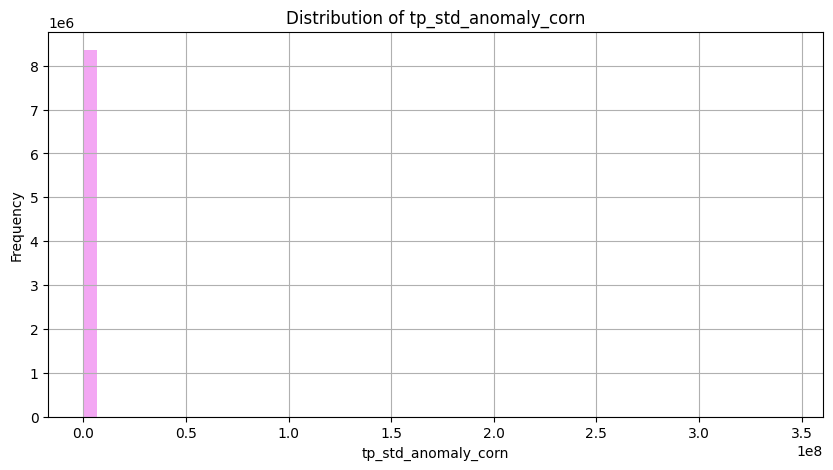

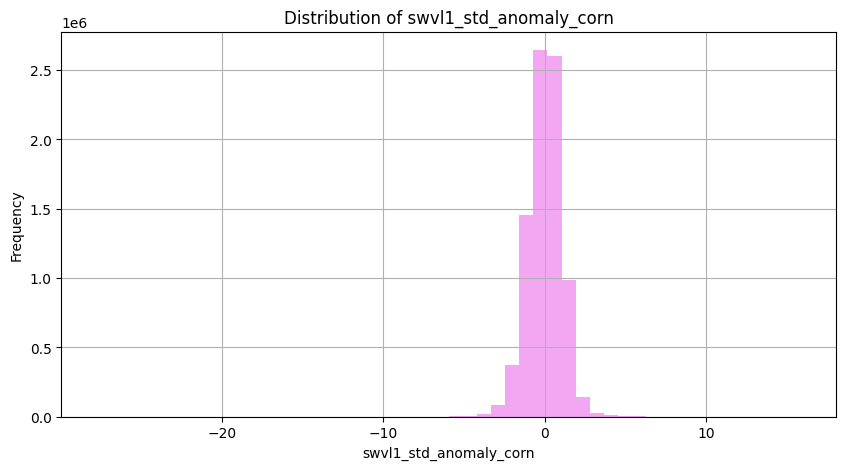

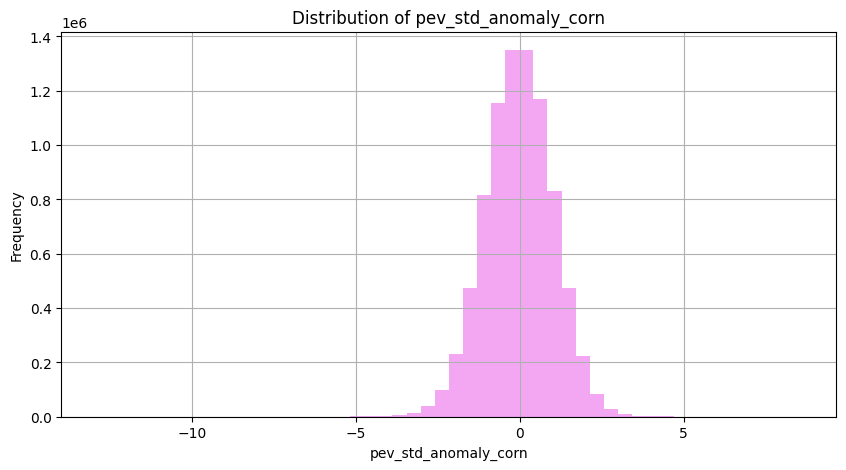

In [36]:
# To plot all variables
plot_variable_distributions(ds)

In [ ]:
ds

<xarray.Dataset> Size: 82GB
Dimensions:                 (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number                  int64 8B 0
  * valid_time              (valid_time) datetime64[ns] 4kB 1979-01-01 ... 20...
  * latitude                (latitude) float64 6kB 90.0 89.75 ... -89.75 -90.0
  * longitude               (longitude) float64 12kB 0.0 0.25 ... 359.5 359.8
    expver                  (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                   (valid_time) int64 4kB 1 2 3 4 5 6 ... 6 7 8 9 10 11
    time                    datetime64[ns] 8B 2024-09-08
Data variables: (12/32)
    cl                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                      ...
    swvl1_std_anomaly       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_pnp_corn             (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_std_anomaly_corn     (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_corn  (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_corn    (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

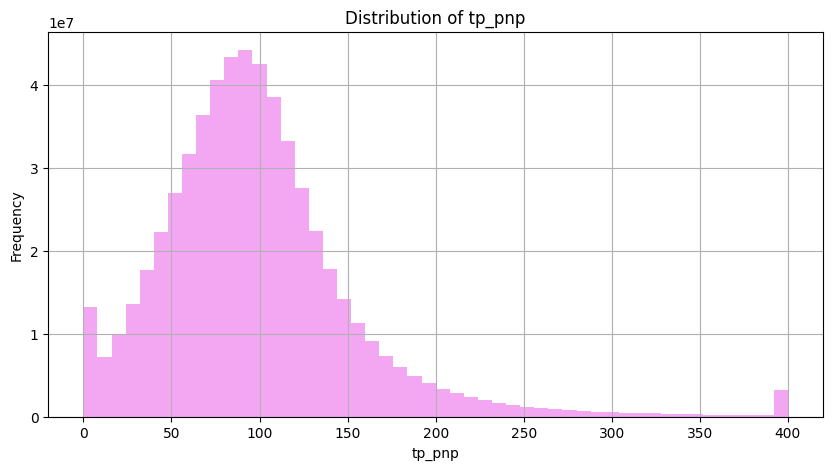

In [ ]:
# To plot specific variables
plot_variable_distributions(ds, variables=['tp_pnp'])

In [133]:
import xarray as xr
import numpy as np

# Definiujemy funkcję przypisującą wartości do binów
def assign_bins(tp_values):
    bins = [0, 50, 100, 150, 200, 250, 300]  # Przedziały
    labels = [0, 1, 2, 3, 4, 5]  # Wartości całkowite odpowiadające przedziałom
    return np.digitize(tp_values, bins, right=False) - 1  # Subtract 1 for 0-based indexing

# Używamy xr.apply_ufunc, aby przypisać biny w całym zestawie danych
tp_pnp_binned = xr.apply_ufunc(
    assign_bins,
    ds['tp_pnp'],
    input_core_dims=[[]],  # Pracujemy na wartościach skalarnych
    vectorize=True,  # Wektorowe działanie na danych
    dask="parallelized",  # Obsługuje dane Dask
    output_dtypes=[int]  # Typ wyjściowy: całkowity
)

# Dodajemy nową zmienną do oryginalnego zbioru danych
ds['tp_pnp_binned'] = tp_pnp_binned


In [136]:
plot_variable_distributions(ds, variables=['tp_pnp_binned'])

## Descriptive statistics

### Summmary statistics

In [79]:
ds

<xarray.Dataset> Size: 82GB
Dimensions:                 (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number                  int64 8B 0
  * valid_time              (valid_time) datetime64[ns] 4kB 1979-01-01 ... 20...
  * latitude                (latitude) float64 6kB 90.0 89.75 ... -89.75 -90.0
  * longitude               (longitude) float64 12kB 0.0 0.25 ... 359.5 359.8
    expver                  (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
    month                   (valid_time) int64 4kB 1 2 3 4 5 6 ... 6 7 8 9 10 11
    time                    datetime64[ns] 8B 2024-09-08
Data variables: (12/32)
    cl                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt                     (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...                      ...
    swvl1_std_anomaly       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_pnp_corn             (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tp_std_anomaly_corn     (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_corn  (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_corn    (valid_time, latitude, longitude) float64 5GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

In [4]:
import xarray as xr
import pandas as pd
import numpy as np

def generate_summary_statistics(ds: xr.Dataset, variable_name: str = None) -> pd.DataFrame:
    """
    Generates summary statistics for a specific variable or all variables in an xarray.Dataset.

    Args:
        ds (xr.Dataset): The input dataset containing multiple variables.
        variable_name (str, optional): The name of the variable for which to compute statistics.
                                       If None, statistics for all variables will be computed.

    Returns:
        pd.DataFrame: A DataFrame with summary statistics for the selected variable or all variables, 
                      including mean, median, min, max, std, and NaN count.
    
    Example:
        summary_df = generate_summary_statistics(ds)
        summary_df_single = generate_summary_statistics(ds, variable_name="temperature")
    """
    # Initialize an empty dictionary to store summary statistics
    stats = {
        "Variable": [],
        "Mean": [],
        "Median": [],
        "Min": [],
        "Max": [],
        "Std": [],
        "NaN Count": []
    }

    # Helper function to calculate statistics for a single variable
    def calculate_stats(var_name, var_data):
        flat_data = var_data.values.flatten()
        stats["Variable"].append(var_name)
        stats["Mean"].append(float(var_data.mean().values))
        stats["Median"].append(float(np.nanmedian(flat_data)))
        stats["Min"].append(float(var_data.min().values))
        stats["Max"].append(float(var_data.max().values))
        stats["Std"].append(float(var_data.std().values))
        stats["NaN Count"].append(int(np.isnan(flat_data).sum()))

    if variable_name:
        # Validate that the variable exists in the dataset
        if variable_name not in ds.data_vars:
            raise ValueError(f"Variable '{variable_name}' not found in the dataset.")
        calculate_stats(variable_name, ds[variable_name])
    else:
        # Calculate statistics for all variables
        for var_name, var_data in ds.data_vars.items():
            calculate_stats(var_name, var_data)

    # Convert the dictionary to a DataFrame for readability
    summary_df = pd.DataFrame(stats)
    
    return summary_df


In [5]:
summary_stats_tp = generate_summary_statistics(ds, 'tp')

In [8]:
summary_df

,Variable,Mean,Median,Min,Max,Std,NaN Count
0,tp,0.0024,0.001566,0.0,0.154491,0.002843,0


# Correlations

In [83]:
import xarray as xr
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

def plot_variable_correlation_heatmap(ds: xr.Dataset) -> None:
    """
    Generates a heatmap of correlations between variables in an xarray.Dataset.

    Args:
        ds (xr.Dataset): The input dataset containing multiple variables.
    
    Example:
        plot_variable_correlation_heatmap(ds)
    """
    
    # Aggregate data by taking the mean over spatial dimensions for each variable
    data_dict = {}
    for var_name, var_data in ds.data_vars.items():
        # Compute the mean across latitude and longitude to get a 1D time series
        time_series = var_data.mean(dim=["latitude", "longitude"], skipna=True)
        data_dict[var_name] = time_series.values

    # Convert to DataFrame for correlation calculation
    df = pd.DataFrame(data_dict, index=ds.valid_time.values)
    
    # Calculate correlation matrix
    corr_matrix = df.corr()

    # Plot heatmap of the correlation matrix with enhanced readability
    plt.figure(figsize=(14, 12))
    sns.heatmap(
        corr_matrix,
        annot=True,
        fmt=".2f",
        cmap="coolwarm",
        center=0,
        square=True,
        cbar_kws={"shrink": 0.8},
        linewidths=0.5,
        annot_kws={"size": 8}
    )
    plt.xticks(rotation=45, ha="right", fontsize=10)
    plt.yticks(fontsize=10)
    plt.title("Correlation Heatmap of Dataset Variables", fontsize=14)
    plt.show()


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/seaborn/matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


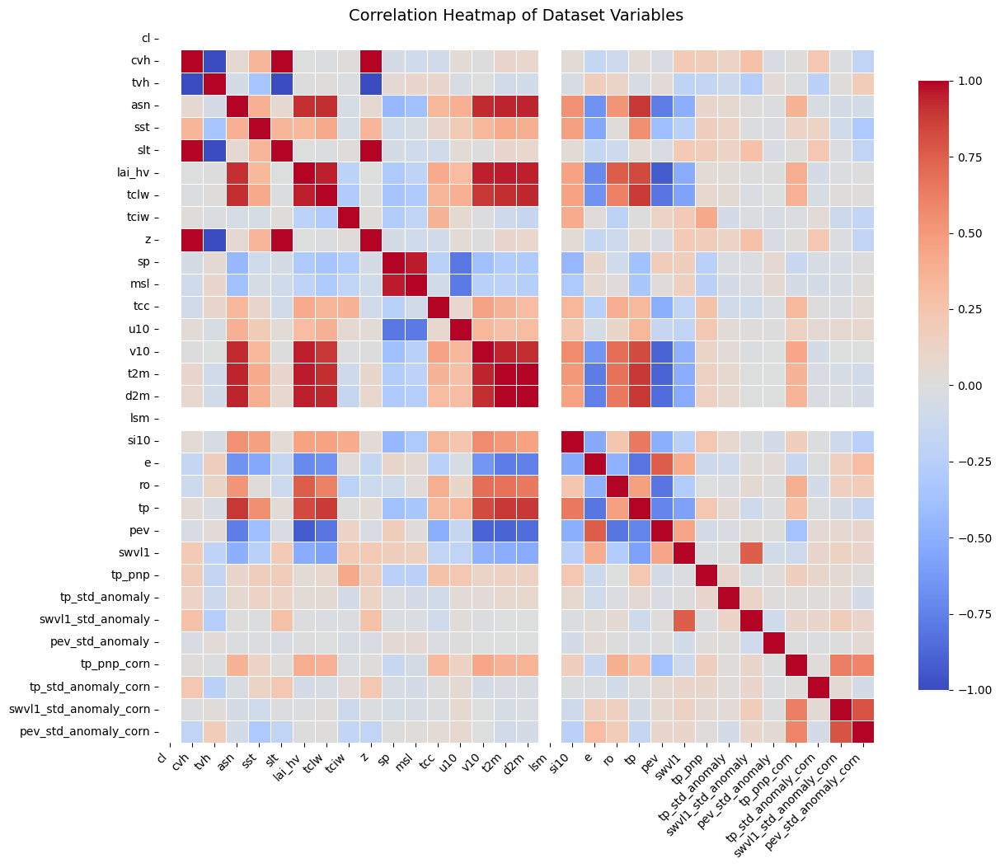

In [84]:
plot_variable_correlation_heatmap(ds)